# Step 2
a. What is the problem the student’s thesis attempts to solve?

b. Why are Bayesian networks well suited to solve it?

c. What are the advantages of using this methodology for this problem?

The thesis attempts to solve the problem of forecasting crude oil prices using probabilistic graphical models and macroeconomic data. The key challenges it aims to address are:

- Existing models like GARCH for forecasting oil prices make simplistic assumptions and do not incorporate broader macroeconomic factors that impact oil markets. The thesis proposes using Bayesian networks built from macroeconomic datasets to model the complex relationships between variables affecting oil prices.
- There are vast amounts of macroeconomic time series data available from government sources like EIA and FRED. But it is difficult for experts to manually construct Bayesian network models that relate all these datasets. The thesis proposes using structural learning algorithms like hill climbing search to learn the network structure directly from the data.
- The macroeconomic data is continuous time series data which needs to be discretized to use in a Bayesian network model with discrete states. The thesis proposes using hidden Markov models (HMMs) to identify latent bull, bear and stagnant regimes in the time series as a preprocessing step before learning the Bayesian network structure.


# Step 3

## Step 3a)

**Student A **- Macroeconomic / geopolitical specialist

Import the Macroeconomic related data

Data sources: https://fred.stlouisfed.org/ & https://www.eia.gov/opendata/

EIA DATASETS used with SeriesId (SHORT-TERM ENERGY OUTLOOK - https://www.eia.gov/outlooks/steo/report/changes.php):

- 'STEO.PAPR_NONOPEC.M',
- 'STEO.PAPR_OPEC.M',
- 'STEO.PATC_OECD.M',
- 'STEO.PATC_NON_OECD.M',
- 'STEO.COPRPUS.M',
- 'STEO.CORIPUS.M',
- 'PET.MCRIMXX2.M',
- 'STEO.PASC_OECD_T3.M',
- 'STEO.COPS_OPEC.M',
- 'STEO.COPC_OPEC.M',
- 'STEO.T3_STCHANGE_OOECD.M',
- 'STEO.T3_STCHANGE_NOECD.M'

FRED DATASETS used (https://fred.stlouisfed.org/)
- 'CPIENGSL',
- 'CAPG211S',
- 'CAPUTLG211S',
- 'IPG211S',
- 'IPG211111CN',
- 'INDPRO',
- 'IPN213111N',
- 'PCU211211'

            

In [95]:
!pip install -qq fredapi
!pip install -qq myeia

In [96]:
# EIA API key
%env EIA_TOKEN=SQDqu9rDVZGiyuTKvLotm34t59vimFfcfXKTpNfe
# FRED API key
fred_key = "b10bfb410f64ebdbd25f00cac14607c3"

env: EIA_TOKEN=SQDqu9rDVZGiyuTKvLotm34t59vimFfcfXKTpNfe


In [97]:
import pandas as pd
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt

from myeia.api import API
from fredapi import Fred
from scipy import stats
import os

In [98]:
# Initiates a session with the EIA repo to recieve datasets
eia_api = API()

# Initiates a session with the FRED repo to recieve datasets
fred = Fred(api_key=fred_key);

In [99]:
# Dataset series ID from the EIA
datasets_eia  = [

                'STEO.PAPR_NONOPEC.M',
                'STEO.PAPR_OPEC.M',
                'STEO.PATC_OECD.M',
                'STEO.PATC_NON_OECD.M',
                'STEO.COPRPUS.M',
                'STEO.CORIPUS.M',
                'PET.MCRIMXX2.M',
                'STEO.PASC_OECD_T3.M',
                'STEO.COPS_OPEC.M',
                'STEO.COPC_OPEC.M',
                'STEO.T3_STCHANGE_OOECD.M',
                'STEO.T3_STCHANGE_NOECD.M',
                ];

# Dataset series ID from the FRED
datasets_fred = [
                'CPIENGSL',
                'CAPG211S',
                'CAPUTLG211S',
                'IPG211S',
                'IPG211111CN',
                'INDPRO',
                'IPN213111N',
                'PCU211211',

                ];

In [100]:
data_merge = []; # List of dataframes to be concatenated

# Adding EIA datasets

for series_id in datasets_eia:
  df = eia_api.get_series(series_id=series_id)
  print(f'Downloading EIA dataset with series_id: {series_id}')
  df.columns = [series_id];
  data_merge.append(df);

# Adding FRED datasets

for series_id in datasets_fred:
  df = pd.DataFrame(fred.get_series(series_id), columns=[series_id]);
  print(f'Downloading FRED dataset with series_id: {series_id}')
  data_merge.append(df);

/usr/local/lib/python3.10/dist-packages/myeia/api.py:111: FutureWarning: Value based partial slicing on non-monotonic DatetimeIndexes with non-existing keys is deprecated and will raise a KeyError in a future Version.
  return df.loc[start_date:end_date]  # type: ignore


/usr/local/lib/python3.10/dist-packages/myeia/api.py:111: FutureWarning: Value based partial slicing on non-monotonic DatetimeIndexes with non-existing keys is deprecated and will raise a KeyError in a future Version.
  return df.loc[start_date:end_date]  # type: ignore


/usr/local/lib/python3.10/dist-packages/myeia/api.py:111: FutureWarning: Value based partial slicing on non-monotonic DatetimeIndexes with non-existing keys is deprecated and will raise a KeyError in a future Version.
  return df.loc[start_date:end_date]  # type: ignore


/usr/local/lib/python3.10/dist-packages/myeia/api.py:111: FutureWarning: Value based partial slicing on non-monotonic DatetimeIndexes with non-existing keys is deprecated and will raise a KeyError in a future Version.
  return df.loc[start_date:end_date]  # type: ignore


/usr/local/lib/python3.10/dist-packages/myeia/api.py:111: FutureWarning: Value based partial slicing on non-monotonic DatetimeIndexes with non-existing keys is deprecated and will raise a KeyError in a future Version.
  return df.loc[start_date:end_date]  # type: ignore


/usr/local/lib/python3.10/dist-packages/myeia/api.py:111: FutureWarning: Value based partial slicing on non-monotonic DatetimeIndexes with non-existing keys is deprecated and will raise a KeyError in a future Version.
  return df.loc[start_date:end_date]  # type: ignore


/usr/local/lib/python3.10/dist-packages/myeia/api.py:111: FutureWarning: Value based partial slicing on non-monotonic DatetimeIndexes with non-existing keys is deprecated and will raise a KeyError in a future Version.
  return df.loc[start_date:end_date]  # type: ignore


/usr/local/lib/python3.10/dist-packages/myeia/api.py:111: FutureWarning: Value based partial slicing on non-monotonic DatetimeIndexes with non-existing keys is deprecated and will raise a KeyError in a future Version.
  return df.loc[start_date:end_date]  # type: ignore


/usr/local/lib/python3.10/dist-packages/myeia/api.py:111: FutureWarning: Value based partial slicing on non-monotonic DatetimeIndexes with non-existing keys is deprecated and will raise a KeyError in a future Version.
  return df.loc[start_date:end_date]  # type: ignore


/usr/local/lib/python3.10/dist-packages/myeia/api.py:111: FutureWarning: Value based partial slicing on non-monotonic DatetimeIndexes with non-existing keys is deprecated and will raise a KeyError in a future Version.
  return df.loc[start_date:end_date]  # type: ignore


/usr/local/lib/python3.10/dist-packages/myeia/api.py:111: FutureWarning: Value based partial slicing on non-monotonic DatetimeIndexes with non-existing keys is deprecated and will raise a KeyError in a future Version.
  return df.loc[start_date:end_date]  # type: ignore


/usr/local/lib/python3.10/dist-packages/myeia/api.py:111: FutureWarning: Value based partial slicing on non-monotonic DatetimeIndexes with non-existing keys is deprecated and will raise a KeyError in a future Version.
  return df.loc[start_date:end_date]  # type: ignore


In [101]:
# Merging the Data
macro_data = pd.concat(data_merge, axis=1, join='inner');

In [102]:
# Renaming the column names
eia_col_map = {
    'STEO.PAPR_NONOPEC.M': 'non_opec_production',
    'STEO.PAPR_OPEC.M': 'opec_production',
    'STEO.PATC_OECD.M': 'oecd_consumption',
    'STEO.PATC_NON_OECD.M': 'non_oecd_consumption',
    'STEO.COPRPUS.M': 'us_refinery_runs',
    'STEO.CORIPUS.M': 'us_crude_imports',
    'PET.MCRIMXX2.M': 'us_opec_imports',
    'STEO.PASC_OECD_T3.M': 'oecd_comm_inventory',
    'STEO.COPS_OPEC.M': 'opec_spare_capacity',
    'STEO.COPC_OPEC.M': 'opec_capacity',
    'STEO.T3_STCHANGE_OOECD.M': 'oecd_inventory_change',
    'STEO.T3_STCHANGE_NOECD.M': 'non_oecd_inventory_change'
}

fred_col_map = {
    'CPIENGSL': 'cpi_energy',
    'CAPG211S': 'capacity_oil_gas',
    'CAPUTLG211S': 'capacity_util_oil_gas',
    'IPG211S': 'ind_prod_oil_gas',
    'IPG211111CN': 'ind_prod_crude_oil',
    'INDPRO': 'ind_prod_total',
    'IPN213111N': 'ind_prod_drilling_wells',
    'PCU211211': 'ppi_oil_gas_extraction'
}

macro_data = macro_data.rename(columns=fred_col_map)
macro_data = macro_data.rename(columns=eia_col_map)

In [103]:
# Take a first look at the data :
# Display the first few rows of the DataFrame
macro_data.head()

,non_opec_production,opec_production,oecd_consumption,non_oecd_consumption,us_refinery_runs,us_crude_imports,us_opec_imports,oecd_comm_inventory,opec_spare_capacity,opec_capacity,oecd_inventory_change,non_oecd_inventory_change,cpi_energy,capacity_oil_gas,capacity_util_oil_gas,ind_prod_oil_gas,ind_prod_crude_oil,ind_prod_total,ind_prod_drilling_wells,ppi_oil_gas_extraction
2021-04-01,63.638367,30.361959,43.318906,52.166955,11.318005,15.162167,848,2911.576995,6.535,31.53,-0.272100,1.208261,228.338,130.7368,94.3495,123.3496,165.4243,98.2886,85.2761,153.0
2021-03-01,63.569437,30.281925,43.697854,51.815354,11.351136,14.387129,704,2915.549210,6.525,31.55,1.950097,-0.034049,227.958,131.0194,93.2076,122.1201,165.8403,98.1351,81.4481,164.0
2021-02-01,60.406017,30.115158,41.908931,51.996820,9.915936,12.370929,634,2968.122920,6.585,31.46,1.249464,0.908418,220.267,131.3435,82.0497,107.7669,150.8145,95.3744,80.6887,189.1
2021-01-01,63.279422,30.599510,41.788083,50.714775,11.137354,14.541839,510,3037.143340,5.685,30.99,-0.509581,-1.067957,211.921,131.7005,92.3355,121.6064,169.2416,98.7836,75.6587,140.8
2020-12-01,62.628221,30.431687,43.114330,50.983447,11.168500,14.139806,336,3027.590711,6.025,31.28,0.889581,-1.315431,206.140,132.0836,90.9267,120.0992,169.6635,97.9754,68.7785,129.3


In [104]:
# Summary of data types and non-null values
macro_data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 219 entries, 2021-04-01 to 2003-02-01
Freq: -1MS
Data columns (total 20 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   non_opec_production        219 non-null    float64
 1   opec_production            219 non-null    float64
 2   oecd_consumption           219 non-null    float64
 3   non_oecd_consumption       219 non-null    float64
 4   us_refinery_runs           219 non-null    float64
 5   us_crude_imports           219 non-null    float64
 6   us_opec_imports            219 non-null    int64  
 7   oecd_comm_inventory        219 non-null    float64
 8   opec_spare_capacity        219 non-null    float64
 9   opec_capacity              219 non-null    float64
 10  oecd_inventory_change      219 non-null    float64
 11  non_oecd_inventory_change  219 non-null    float64
 12  cpi_energy                 219 non-null    float64
 13  capacity_oil_gas    

In [105]:
# Check for missing values in each column
print("Missing values for each column:")
macro_data.isna().sum()

Missing values for each column:


non_opec_production          0
opec_production              0
oecd_consumption             0
non_oecd_consumption         0
us_refinery_runs             0
us_crude_imports             0
us_opec_imports              0
oecd_comm_inventory          0
opec_spare_capacity          0
opec_capacity                0
oecd_inventory_change        0
non_oecd_inventory_change    0
cpi_energy                   0
capacity_oil_gas             0
capacity_util_oil_gas        0
ind_prod_oil_gas             0
ind_prod_crude_oil           0
ind_prod_total               0
ind_prod_drilling_wells      0
ppi_oil_gas_extraction       0
dtype: int64

In [106]:
# Summary statistics for each column
print("Summary statistics:")
macro_data.describe()

Summary statistics:


,non_opec_production,opec_production,oecd_consumption,non_oecd_consumption,us_refinery_runs,us_crude_imports,us_opec_imports,oecd_comm_inventory,opec_spare_capacity,opec_capacity,oecd_inventory_change,non_oecd_inventory_change,cpi_energy,capacity_oil_gas,capacity_util_oil_gas,ind_prod_oil_gas,ind_prod_crude_oil,ind_prod_total,ind_prod_drilling_wells,ppi_oil_gas_extraction
count,219.000000,219.000000,219.000000,219.000000,219.000000,219.000000,219.000000,219.000000,219.000000,219.000000,219.000000,219.000000,219.000000,219.000000,219.000000,219.000000,219.000000,219.000000,219.000000,219.000000
mean,56.342653,34.276129,47.403055,43.446875,7.460425,15.409335,3693.328767,2754.472693,2.554905,32.072301,-0.001067,0.294391,207.153269,85.561489,94.336924,81.044295,114.348820,97.366103,124.969295,207.882648
std,5.191465,2.009871,2.451402,7.007928,2.468107,0.980251,1358.056954,171.441422,1.523656,1.321025,0.755406,1.565385,31.365512,25.114808,3.881622,25.054611,37.525287,4.623972,31.370749,72.392588
min,48.895490,27.372721,34.989992,29.941029,3.973586,12.370929,336.000000,2394.414000,0.660000,27.293232,-2.367733,-10.628674,129.400000,61.470000,78.641800,48.807600,60.981300,84.597900,47.951500,54.600000
25%,51.381186,33.449105,46.126878,37.248215,5.396273,14.761163,2838.500000,2632.945932,1.530000,31.350639,-0.471609,-0.422996,192.121500,63.704750,92.125850,58.709100,82.836500,94.014350,105.761250,149.300000
50%,54.879612,34.375071,47.365570,44.076532,6.275412,15.361032,3987.000000,2689.440221,2.240000,32.170000,0.011000,0.470932,208.973000,73.585000,94.322500,71.479500,96.438100,98.466900,124.691100,203.000000
75%,60.679247,35.595362,48.792925,50.015356,9.345264,16.054565,4762.000000,2864.900708,2.820115,32.951000,0.455984,1.119435,229.137000,102.796450,97.005900,99.157750,143.570950,101.051650,149.277850,258.150000
max,67.463929,37.820524,52.875618,54.007979,13.000326,17.665667,5836.000000,3211.628995,8.520000,34.366521,2.317742,3.481262,271.149000,135.005700,101.558700,136.175800,196.833100,104.118100,196.215100,490.400000


In [107]:
# Check for duplicate rows
duplicate_rows = macro_data.duplicated()
print(f"Number of duplicate rows: {duplicate_rows.sum()}")

# Remove duplicate rows, if any
if duplicate_rows.sum() > 0:
    macro_data.drop_duplicates(inplace=True)

Number of duplicate rows: 0


In [108]:
macro_data.index

DatetimeIndex(['2021-04-01', '2021-03-01', '2021-02-01', '2021-01-01',
               '2020-12-01', '2020-11-01', '2020-10-01', '2020-09-01',
               '2020-08-01', '2020-07-01',
               ...
               '2003-11-01', '2003-10-01', '2003-09-01', '2003-08-01',
               '2003-07-01', '2003-06-01', '2003-05-01', '2003-04-01',
               '2003-03-01', '2003-02-01'],
              dtype='datetime64[ns]', length=219, freq='-1MS')

## Step 3b)

**Student B** - Microeconomic specialist

Import the Microeconomic related data

In [109]:
import yfinance as yf
import pandas as pd
import matplotlib.pyplot as plt

In [110]:
crude_oil_symbol = "CL=F"  # Crude oil futures
stock_index_symbol = "^GSPC"  # S&P 500 index
currency_symbol = "USDEUR=X"  # USD to EUR exchange rate
UKetf_symbol="ISF.L"#UK ETF
realestate_symbol="ESS"
bond_symbol="TLT"#US bond index data

In [111]:
Start_Date = '2003-02-01'
End_Date = "2021-04-02"

In [112]:
#data extraction
crude_oil_data = yf.download(crude_oil_symbol, start=Start_Date, end=End_Date)
stock_index_data = yf.download(stock_index_symbol, start=Start_Date, end=End_Date)
currency_data = yf.download(currency_symbol, start=Start_Date, end=End_Date)
UKetf_data = yf.download(UKetf_symbol, start=Start_Date, end=End_Date)
re_data = yf.download(realestate_symbol, start=Start_Date, end=End_Date)
bond_data=yf.download(bond_symbol, start=Start_Date, end=End_Date)

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


Returns data

In [113]:
#returns data
crude_oil_data['returns'] =crude_oil_data['Adj Close'].pct_change()
print(crude_oil_data.info())
crude_oil_data.head()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4565 entries, 2003-02-03 to 2021-04-01
Data columns (total 7 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Open       4565 non-null   float64
 1   High       4565 non-null   float64
 2   Low        4565 non-null   float64
 3   Close      4565 non-null   float64
 4   Adj Close  4565 non-null   float64
 5   Volume     4565 non-null   int64  
 6   returns    4564 non-null   float64
dtypes: float64(6), int64(1)
memory usage: 285.3 KB
None


,Open,High,Low,Close,Adj Close,Volume,returns
Date,,,,,,,
2003-02-03,33.330002,33.470001,32.650002,32.759998,32.759998,74746,NaN
2003-02-04,32.900002,33.779999,32.900002,33.580002,33.580002,81566,0.025031
2003-02-05,33.700001,34.279999,33.099998,33.930000,33.930000,88323,0.010423
2003-02-06,34.250000,34.450001,33.779999,34.160000,34.160000,85546,0.006779
2003-02-07,34.500000,35.250000,34.349998,35.119999,35.119999,99482,0.028103


In [114]:
stock_index_data['returns'] = stock_index_data['Adj Close'].pct_change()
print(stock_index_data.info())
stock_index_data.head()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4573 entries, 2003-02-03 to 2021-04-01
Data columns (total 7 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Open       4573 non-null   float64
 1   High       4573 non-null   float64
 2   Low        4573 non-null   float64
 3   Close      4573 non-null   float64
 4   Adj Close  4573 non-null   float64
 5   Volume     4573 non-null   int64  
 6   returns    4572 non-null   float64
dtypes: float64(6), int64(1)
memory usage: 285.8 KB
None


,Open,High,Low,Close,Adj Close,Volume,returns
Date,,,,,,,
2003-02-03,855.700012,864.640015,855.700012,860.320007,860.320007,1258500000,NaN
2003-02-04,860.320007,860.320007,840.190002,848.200012,848.200012,1451600000,-0.014088
2003-02-05,848.200012,861.630005,842.109985,843.590027,843.590027,1450800000,-0.005435
2003-02-06,843.590027,844.229980,833.250000,838.150024,838.150024,1430900000,-0.006449
2003-02-07,838.150024,845.729980,826.700012,829.690002,829.690002,1276800000,-0.010094


In [115]:
currency_data['returns'] = currency_data['Adj Close'].pct_change().dropna()
print(currency_data.info())
currency_data.head()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4495 entries, 2003-12-01 to 2021-04-01
Data columns (total 7 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Open       4495 non-null   float64
 1   High       4495 non-null   float64
 2   Low        4495 non-null   float64
 3   Close      4495 non-null   float64
 4   Adj Close  4495 non-null   float64
 5   Volume     4495 non-null   int64  
 6   returns    4494 non-null   float64
dtypes: float64(6), int64(1)
memory usage: 280.9 KB
None


,Open,High,Low,Close,Adj Close,Volume,returns
Date,,,,,,,
2003-12-01,0.83098,0.83724,0.83056,0.83577,0.83577,0,NaN
2003-12-02,0.83605,0.83710,0.82583,0.82720,0.82720,0,-0.010254
2003-12-03,0.82713,0.82802,0.82440,0.82488,0.82488,0,-0.002805
2003-12-04,0.82508,0.83029,0.82345,0.82775,0.82775,0,0.003479
2003-12-05,0.82795,0.82878,0.82028,0.82055,0.82055,0,-0.008698


In [116]:
re_data['returns'] = re_data['Adj Close'].pct_change()
print(re_data.info())
re_data.head()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4573 entries, 2003-02-03 to 2021-04-01
Data columns (total 7 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Open       4573 non-null   float64
 1   High       4573 non-null   float64
 2   Low        4573 non-null   float64
 3   Close      4573 non-null   float64
 4   Adj Close  4573 non-null   float64
 5   Volume     4573 non-null   int64  
 6   returns    4572 non-null   float64
dtypes: float64(6), int64(1)
memory usage: 285.8 KB
None


,Open,High,Low,Close,Adj Close,Volume,returns
Date,,,,,,,
2003-02-03,50.599998,51.000000,49.700001,49.849998,24.286499,150800,NaN
2003-02-04,49.849998,50.459999,49.799999,50.450001,24.578815,84600,0.012036
2003-02-05,50.430000,50.590000,50.009998,50.439999,24.573944,169000,-0.000198
2003-02-06,50.599998,51.130001,50.299999,50.400002,24.554453,85900,-0.000793
2003-02-07,50.400002,50.419998,50.259998,50.259998,24.486244,51500,-0.002778


In [117]:
bond_data['returns'] = bond_data['Adj Close'].pct_change()
print(bond_data.info())
bond_data.head()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4573 entries, 2003-02-03 to 2021-04-01
Data columns (total 7 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Open       4573 non-null   float64
 1   High       4573 non-null   float64
 2   Low        4573 non-null   float64
 3   Close      4573 non-null   float64
 4   Adj Close  4573 non-null   float64
 5   Volume     4573 non-null   int64  
 6   returns    4572 non-null   float64
dtypes: float64(6), int64(1)
memory usage: 285.8 KB
None


,Open,High,Low,Close,Adj Close,Volume,returns
Date,,,,,,,
2003-02-03,87.669998,87.910004,87.309998,87.879997,44.652786,55200,NaN
2003-02-04,88.370003,88.400002,88.110001,88.269997,44.850967,56900,0.004438
2003-02-05,88.230003,88.699997,87.430000,87.510002,44.464809,223300,-0.008610
2003-02-06,87.839996,88.260002,87.790001,88.220001,44.825550,120900,0.008113
2003-02-07,87.769997,88.519997,87.629997,88.419998,44.927197,247200,0.002268


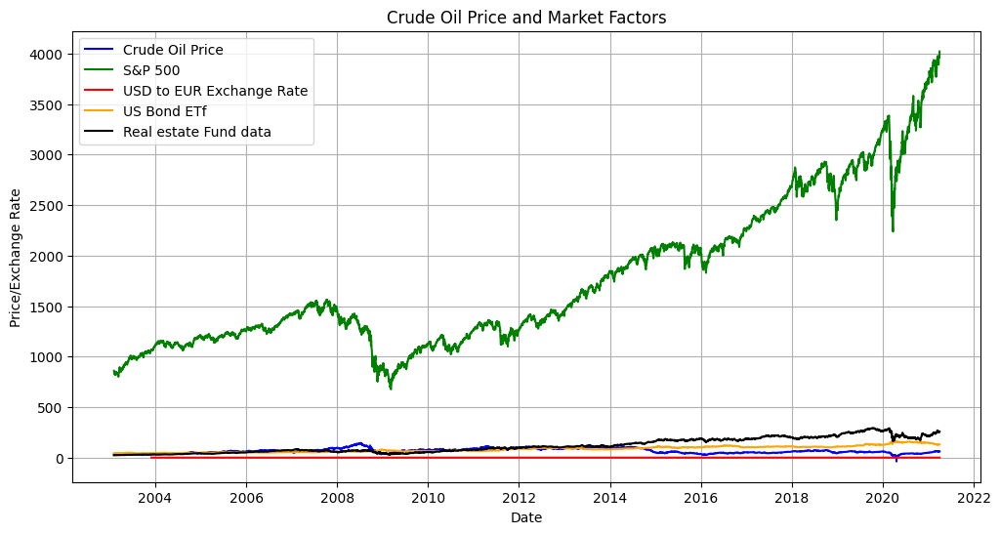

In [118]:
plt.figure(figsize=(12, 6))
plt.plot(crude_oil_data['Adj Close'], label='Crude Oil Price', color='blue')
plt.plot(stock_index_data['Adj Close'], label='S&P 500', color='green')
plt.plot(currency_data['Adj Close'], label='USD to EUR Exchange Rate', color='red')
plt.plot(bond_data['Adj Close'], label='US Bond ETf', color='orange')
plt.plot(re_data['Adj Close'], label='Real estate Fund data', color='black')
plt.legend()
plt.title('Crude Oil Price and Market Factors')
plt.xlabel('Date')
plt.ylabel('Price/Exchange Rate')
plt.grid(True)
plt.show()

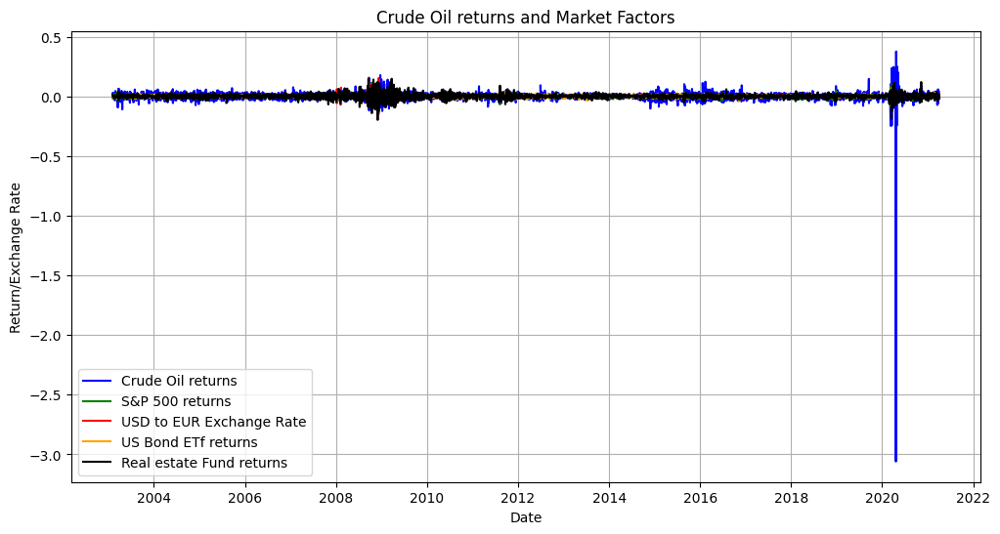

In [119]:
plt.figure(figsize=(12, 6))
plt.plot(crude_oil_data['returns'], label='Crude Oil returns', color='blue')
plt.plot(stock_index_data['returns'], label='S&P 500 returns', color='green')
plt.plot(currency_data['returns'], label='USD to EUR Exchange Rate', color='red')
plt.plot(bond_data['returns'], label='US Bond ETf returns', color='orange')
plt.plot(re_data['returns'], label='Real estate Fund returns', color='black')
plt.legend()
plt.title('Crude Oil returns and Market Factors')
plt.xlabel('Date')
plt.ylabel('Return/Exchange Rate')
plt.grid(True)
plt.show()

In [120]:
crude_oil_data['returns'].corr(stock_index_data['returns'])

0.15491622560087975

In [121]:
crude_oil_data['returns'].corr(currency_data['returns'])

-0.05136500231502397

In [122]:
crude_oil_data['returns'].corr(bond_data['returns'])

-0.10707840345059476

In [123]:
crude_oil_data['returns'].corr(re_data['returns'])

0.09855514340048951

## Step 3c)

**Student C**- Financial specialist

Import the financial related data

In [124]:
import pandas_datareader as pdr
import datetime

# Define the start and end dates for the data extraction
start_date = datetime.datetime(2003, 1, 2)
end_date = datetime.datetime(2021, 4, 1)

# Define the list of data series codes
data_series = ["PAYEMS", "UNRATE", "USACPICORMINMEI"]

# Initialize an empty DataFrame to store the data
financial_data = pd.DataFrame()

# Loop through each data series and extract the data
for series_code in data_series:
    # Use pandas_datareader to fetch data from FRED
    df = pdr.DataReader(series_code, "fred", start_date, end_date)

    # Rename the column to the series code for clarity
    df.rename(columns={series_code: series_code}, inplace=True)

    # Concatenate the data into the financial_data DataFrame
    financial_data = pd.concat([financial_data, df], axis=1)

# Print the first few rows of the extracted data
print(financial_data.head())

            PAYEMS  UNRATE  USACPICORMINMEI
DATE                                       
2003-02-01  130443     5.9        79.464512
2003-03-01  130233     5.9        79.670914
2003-04-01  130176     6.0        79.712194
2003-05-01  130197     6.1        79.753474
2003-06-01  130192     6.3        79.670914


Crude oil data

In [125]:
# Retrieve data from FRED API
fred_crudeoilprice_data = pd.DataFrame(fred.get_series('WTISPLC'), columns=['WTISPLC'])
fred_crudeoilprice_data['returns']=fred_crudeoilprice_data['WTISPLC'].pct_change()

In [126]:
fred_crudeoilprice_data.describe()

,WTISPLC,returns
count,931.000000,930.000000
mean,27.195888,0.007585
std,28.886527,0.084275
min,1.170000,-0.433413
25%,3.000000,-0.000149
50%,18.100000,0.000000
75%,38.000000,0.023333
max,133.930000,1.345708


# Step 4
Dictionary of the data used and a table showing the data, frequency, source, start date, end date, and other relevant fields.

In [127]:
from tabulate import tabulate

data = [['non_opec_production','Monthly','EIA','2003-02-01','2021-04-01','Macroeconomic'],
        ['opec_production','Monthly','EIA','2003-02-01','2021-04-01','Macroeconomic'],
        ['oecd_consumption','Monthly','EIA','2003-02-01','2021-04-01','Macroeconomic'],
        ['non_oecd_consumption','Monthly','EIA','2003-02-01','2021-04-01','Macroeconomic'],
        ['us_refinery_runs','Monthly','EIA','2003-02-01','2021-04-01','Macroeconomic'],
        ['us_crude_imports','Monthly','EIA','2003-02-01','2021-04-01','Macroeconomic'],
        ['us_opec_imports','Monthly','EIA','2003-02-01','2021-04-01','Macroeconomic'],
        ['oecd_comm_inventory','Monthly','EIA','2003-02-01','2021-04-01','Macroeconomic'],
        ['opec_spare_capacity','Monthly','EIA','2003-02-01','2021-04-01','Macroeconomic'],
        ['opec_capacity','Monthly','EIA','2003-02-01','2021-04-01','Macroeconomic'],
        ['oecd_inventory_change','Monthly','EIA','2003-02-01','2021-04-01','Macroeconomic'],
        ['non_oecd_inventory_change','Monthly','EIA','2003-02-01','2021-04-01','Macroeconomic'],
        ['cpi_energy','Monthly','FRED','2003-02-01','2021-04-01','Macroeconomic'],
        ['capacity_oil_gas','Monthly','FRED','2003-02-01','2021-04-01','Macroeconomic'],
        ['capacity_util_oil_gas','Monthly','FRED','2003-02-01','2021-04-01','Macroeconomic'],
        ['ind_prod_oil_gas','Monthly','FRED','2003-02-01','2021-04-01','Macroeconomic'],
        ['ind_prod_crude_oil','Monthly','FRED','2003-02-01','2021-04-01','Macroeconomic'],
        ['ind_prod_total','Monthly','FRED','2003-02-01','2021-04-01','Macroeconomic'],
        ['ind_prod_drilling_wells','Monthly','FRED','2003-02-01','2021-04-01','Macroeconomic'],
        ['ppi_oil_gas_extraction','Monthly','FRED','2003-02-01','2021-04-01','Macroeconomic']]

df = pd.DataFrame(data, columns=['Variable','Frequency','Source','Start Date','End Date', 'Data Type'])

metadata = df.to_dict('records')
print(metadata)

[{'Variable': 'non_opec_production', 'Frequency': 'Monthly', 'Source': 'EIA', 'Start Date': '2003-02-01', 'End Date': '2021-04-01', 'Data Type': 'Macroeconomic'}, {'Variable': 'opec_production', 'Frequency': 'Monthly', 'Source': 'EIA', 'Start Date': '2003-02-01', 'End Date': '2021-04-01', 'Data Type': 'Macroeconomic'}, {'Variable': 'oecd_consumption', 'Frequency': 'Monthly', 'Source': 'EIA', 'Start Date': '2003-02-01', 'End Date': '2021-04-01', 'Data Type': 'Macroeconomic'}, {'Variable': 'non_oecd_consumption', 'Frequency': 'Monthly', 'Source': 'EIA', 'Start Date': '2003-02-01', 'End Date': '2021-04-01', 'Data Type': 'Macroeconomic'}, {'Variable': 'us_refinery_runs', 'Frequency': 'Monthly', 'Source': 'EIA', 'Start Date': '2003-02-01', 'End Date': '2021-04-01', 'Data Type': 'Macroeconomic'}, {'Variable': 'us_crude_imports', 'Frequency': 'Monthly', 'Source': 'EIA', 'Start Date': '2003-02-01', 'End Date': '2021-04-01', 'Data Type': 'Macroeconomic'}, {'Variable': 'us_opec_imports', 'Freque

In [128]:
print(tabulate(df, headers='keys', tablefmt='pipe'))

|    | Variable                  | Frequency   | Source   | Start Date   | End Date   | Data Type     |
|---:|:--------------------------|:------------|:---------|:-------------|:-----------|:--------------|
|  0 | non_opec_production       | Monthly     | EIA      | 2003-02-01   | 2021-04-01 | Macroeconomic |
|  1 | opec_production           | Monthly     | EIA      | 2003-02-01   | 2021-04-01 | Macroeconomic |
|  2 | oecd_consumption          | Monthly     | EIA      | 2003-02-01   | 2021-04-01 | Macroeconomic |
|  3 | non_oecd_consumption      | Monthly     | EIA      | 2003-02-01   | 2021-04-01 | Macroeconomic |
|  4 | us_refinery_runs          | Monthly     | EIA      | 2003-02-01   | 2021-04-01 | Macroeconomic |
|  5 | us_crude_imports          | Monthly     | EIA      | 2003-02-01   | 2021-04-01 | Macroeconomic |
|  6 | us_opec_imports           | Monthly     | EIA      | 2003-02-01   | 2021-04-01 | Macroeconomic |
|  7 | oecd_comm_inventory       | Monthly     | EIA      | 2003

For micro economic data we used US Stock market index data, US realestate etf,  bond etf and UK vs US exchange rate data.

Data discription

In [129]:
print(crude_oil_data.info())
print(stock_index_data.info())
print(currency_data.info())
print(re_data.info() )
print(bond_data.info())

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4565 entries, 2003-02-03 to 2021-04-01
Data columns (total 7 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Open       4565 non-null   float64
 1   High       4565 non-null   float64
 2   Low        4565 non-null   float64
 3   Close      4565 non-null   float64
 4   Adj Close  4565 non-null   float64
 5   Volume     4565 non-null   int64  
 6   returns    4564 non-null   float64
dtypes: float64(6), int64(1)
memory usage: 414.4 KB
None
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4573 entries, 2003-02-03 to 2021-04-01
Data columns (total 7 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Open       4573 non-null   float64
 1   High       4573 non-null   float64
 2   Low        4573 non-null   float64
 3   Close      4573 non-null   float64
 4   Adj Close  4573 non-null   float64
 5   Volume     4573 non-null   int64  
 6   returns   

In [130]:
crude_oil_data.describe()

,Open,High,Low,Close,Adj Close,Volume,returns
count,4565.000000,4565.000000,4565.000000,4565.000000,4565.000000,4.565000e+03,4564.000000
mean,66.414497,67.402808,65.350438,66.409268,66.409268,3.286383e+05,-0.000325
std,23.853236,24.009426,23.681997,23.877756,23.877756,2.200931e+05,0.055825
min,-14.000000,13.690000,-40.320000,-37.630001,-37.630001,2.000000e+01,-3.059661
25%,48.299999,48.980000,47.279999,48.230000,48.230000,1.559630e+05,-0.012263
50%,61.750000,62.549999,60.849998,61.720001,61.720001,2.798800e+05,0.000950
75%,86.379997,87.470001,85.160004,86.320000,86.320000,4.329880e+05,0.012844
max,145.190002,147.270004,143.220001,145.289993,145.289993,2.288230e+06,0.376623


In [131]:
stock_index_data.describe()

,Open,High,Low,Close,Adj Close,Volume,returns
count,4573.000000,4573.000000,4573.000000,4573.000000,4573.000000,4.573000e+03,4572.000000
mean,1760.554830,1770.299556,1750.164265,1760.926531,1760.926531,3.539472e+09,0.000410
std,733.703374,736.553935,730.445343,733.758043,733.758043,1.402264e+09,0.012086
min,679.280029,695.270020,666.789978,676.530029,676.530029,3.560700e+08,-0.119841
25%,1196.540039,1203.829956,1188.920044,1197.300049,1197.300049,2.717630e+09,-0.003987
50%,1443.670044,1450.199951,1433.219971,1443.760010,1443.760010,3.502320e+09,0.000730
75%,2164.189941,2169.600098,2155.790039,2163.790039,2163.790039,4.215620e+09,0.005582
max,3992.780029,4020.629883,3992.780029,4019.870117,4019.870117,1.145623e+10,0.115800


In [132]:
currency_data.describe()

,Open,High,Low,Close,Adj Close,Volume,returns
count,4495.000000,4495.000000,4495.000000,4495.000000,4495.000000,4495.0,4494.000000
mean,0.801487,0.807544,0.798483,0.801469,0.801469,0.0,0.000032
std,0.075387,0.206972,0.075279,0.075375,0.075375,0.0,0.007454
min,0.625710,0.629960,0.623900,0.625470,0.625470,0.0,-0.147542
25%,0.743930,0.746965,0.741513,0.744020,0.744020,0.0,-0.003343
50%,0.795190,0.798610,0.791390,0.794910,0.794910,0.0,-0.000061
75%,0.865585,0.868840,0.862155,0.865685,0.865685,0.0,0.003311
max,0.962100,13.717000,0.959700,0.962420,0.962420,0.0,0.154103


In [133]:
re_data.describe()

,Open,High,Low,Close,Adj Close,Volume,returns
count,4573.000000,4573.000000,4573.000000,4573.000000,4573.000000,4.573000e+03,4572.000000
mean,158.112447,159.739532,156.430667,158.159644,119.251284,3.618552e+05,0.000704
std,73.266101,73.780780,72.668500,73.227502,72.195765,3.909986e+05,0.019354
min,49.430000,50.169998,49.189999,49.799999,24.262135,1.990000e+04,-0.197063
25%,97.599998,98.660004,96.169998,97.489998,57.698059,1.932000e+05,-0.007338
50%,143.210007,144.440002,141.979996,143.369995,101.142532,2.963000e+05,0.000919
75%,225.869995,227.869995,223.360001,226.020004,182.514084,4.259000e+05,0.008863
max,333.260010,334.170013,330.709991,332.540009,293.168121,1.895350e+07,0.148709


In [134]:
bond_data.describe()

,Open,High,Low,Close,Adj Close,Volume,returns
count,4573.000000,4573.000000,4573.000000,4573.000000,4573.000000,4.573000e+03,4572.000000
mean,110.036650,110.525268,109.558412,110.047520,84.073458,6.193753e+06,0.000272
std,20.798154,20.917172,20.674233,20.783329,29.395557,5.281297e+06,0.008778
min,80.889999,80.919998,80.510002,80.650002,42.368759,4.270000e+04,-0.066683
25%,91.099998,91.470001,90.730003,91.089996,55.571510,1.765300e+06,-0.004744
50%,108.180000,108.690002,107.629997,108.290001,84.099968,5.675300e+06,0.000554
75%,123.080002,123.559998,122.629997,123.059998,105.888397,8.859500e+06,0.005311
max,179.100006,179.699997,170.779999,171.570007,160.762772,7.628830e+07,0.075195


For financial data selection, we have opted for the following key indicators:

Non-Farm Payroll (US) - Represented by the code PAYEMS, this metric gauges the total number of non-farm workers in the United States. It is measured on a monthly basis and can be accessed at the following link: Non-Farm Payroll Data.

US Unemployment Rate - Tracked by the code UNRATE, the US Unemployment Rate is a monthly series compiled by the Bureau of Labor Statistics (BLS). It is calculated as the ratio of unemployed individuals to the total labor force in the United States. You can find this data here: US Unemployment Rate Data.

US Core CPI (Excluding Food/Energy) - Identified as USACPICORMINMEI, this data series is provided by the OECD and represents the Consumer Price Index (CPI) for all items in the United States, excluding food and energy components. It is reported on a monthly basis and can be accessed via the following link: US Core CPI Data.

These indicators are valuable for assessing the economic health and stability of the United States, providing insights into labor market dynamics and inflation trends.

In [135]:
financial_data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 219 entries, 2003-02-01 to 2021-04-01
Data columns (total 3 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   PAYEMS           219 non-null    int64  
 1   UNRATE           219 non-null    float64
 2   USACPICORMINMEI  219 non-null    float64
dtypes: float64(2), int64(1)
memory usage: 6.8 KB


# Step 5 - Data Cleaning



## Step 5a)
Student A - Outlier Detection


In [136]:
# Cleaning Extreme Outliers (using Z-score)
def detect_outliers_zscore(df, threshold=3):
    outliers = {}
    for column in df.columns:
        z_scores = np.abs((df[column] - df[column].mean()) / df[column].std())
        outlier_indices = np.where(z_scores > threshold)[0]
        if len(outlier_indices) > 0:
            outliers[column] = outlier_indices
    return outliers

# Function to extract outlier rows
def extract_outliers(df, outliers_dict):
    outlier_data = {}
    for column, outlier_indices in outliers_dict.items():
        outlier_data[column] = df.iloc[outlier_indices][column]
    return pd.DataFrame.from_dict(outlier_data)

def replace_outliers_with_median(macro_data, outliers_dict):
    for column, outlier_indices in outliers_dict.items():
        print(f"Handling outliers for {column}")

        # Convert row numbers to DatetimeIndex
        outlier_dates = macro_data.index[outlier_indices]

        # Check if there are valid dates for the outliers
        if outlier_dates.empty:
            print("No valid dates for outliers.")
            continue

        # Replace outliers with median value
        median_value = macro_data.loc[:, column].median()
        macro_data.loc[outlier_dates, column] = median_value

    return macro_data


In [137]:
# Detect outliers
outliers_dict = detect_outliers_zscore(macro_data)

In [138]:
# Extract and display outliers
outlier_data = extract_outliers(macro_data, outliers_dict)
print("Outlier data:")
print(outlier_data)

Outlier data:
            opec_production  oecd_consumption  us_crude_imports  \
2003-04-01              NaN               NaN               NaN   
2003-05-01              NaN               NaN               NaN   
2003-06-01              NaN               NaN               NaN   
2004-12-01              NaN               NaN               NaN   
2005-09-01              NaN               NaN               NaN   
2005-10-01              NaN               NaN               NaN   
2008-05-01              NaN               NaN               NaN   
2008-06-01              NaN               NaN               NaN   
2008-07-01              NaN               NaN               NaN   
2008-09-01              NaN               NaN               NaN   
2020-01-01              NaN               NaN               NaN   
2020-02-01              NaN               NaN               NaN   
2020-03-01              NaN               NaN               NaN   
2020-04-01              NaN         34.989992   

In [139]:
cleaned_data = replace_outliers_with_median(macro_data, outliers_dict)

Handling outliers for opec_production
Handling outliers for oecd_consumption
Handling outliers for us_crude_imports
Handling outliers for opec_spare_capacity
Handling outliers for opec_capacity
Handling outliers for oecd_inventory_change
Handling outliers for non_oecd_inventory_change
Handling outliers for capacity_util_oil_gas
Handling outliers for ppi_oil_gas_extraction


## Step 5b)
Student B - Bad Data


Not required as the API helped us deal with these issues.




## Step 5c)
Student C - Missing Values

We need to remove the first data point from fred crude oil prices and the microeconomic data so as to ensure no "nan" in returns column.


In [140]:
crude_oil_data.dropna(inplace=True)
stock_index_data.dropna(inplace=True)
currency_data.dropna(inplace=True)
re_data.dropna(inplace=True)

In [141]:
bond_data.dropna(inplace=True)
fred_crudeoilprice_data.dropna(inplace=True)

# Step 6 - Exploratory data analysis
why certain data points/events/periods of time
were eliminated from the model’s data?

Looking at the outlier data, it is clear that the outliers are sporadic across different columns (and only 18 rows out of 219 entries) and are especially concentrated in particular years (e.g., 2003, 2008, 2020). The NaN values signify that there are no outliers in those particular columns for the given rows.Deciding to replace them with statistical measures like median, as we don't want to lose the data.

## Step 7a)
Student A - “Distributional” plots.


In [142]:
!pip install -qq seaborn

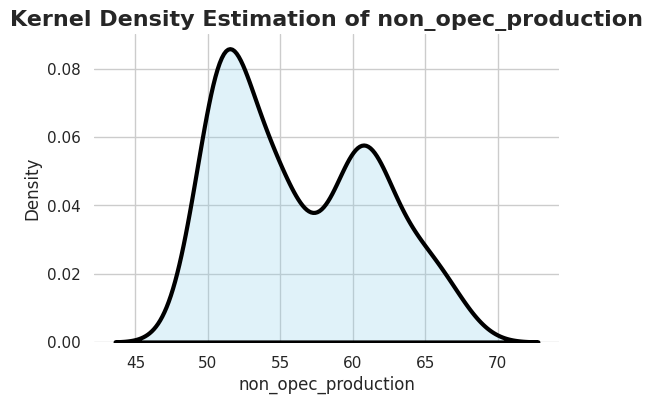

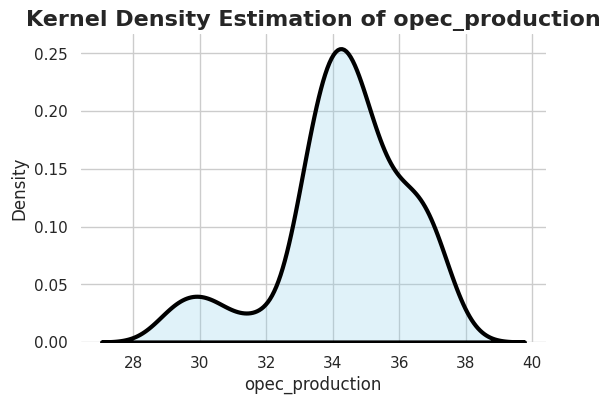

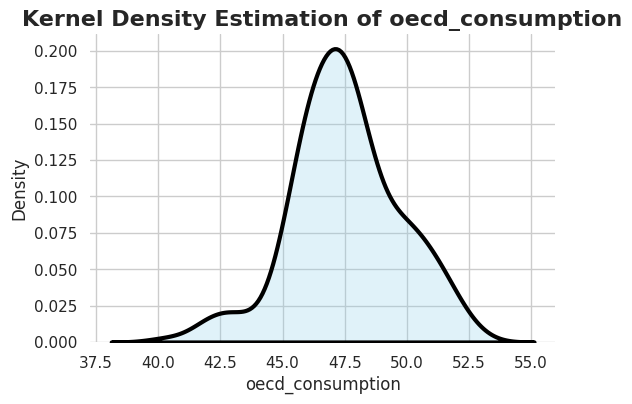

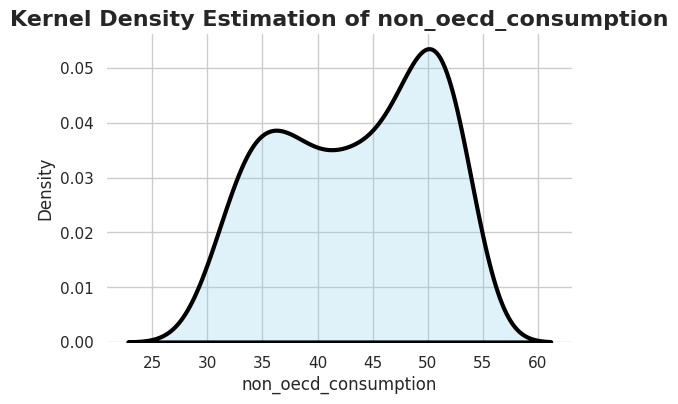

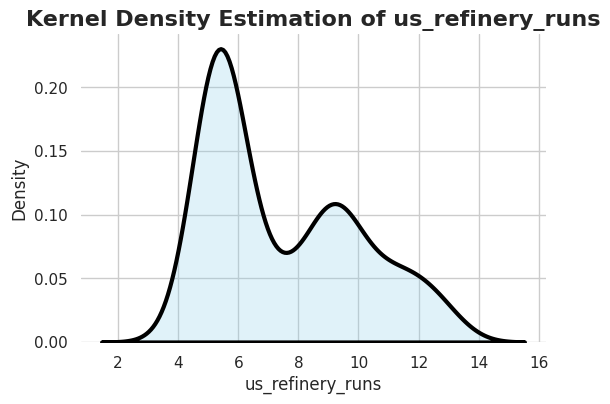

...

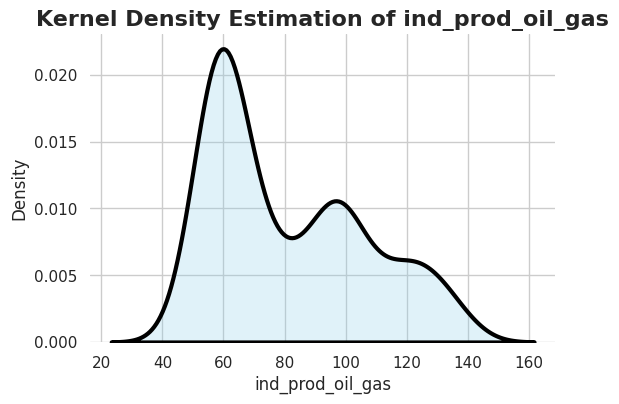

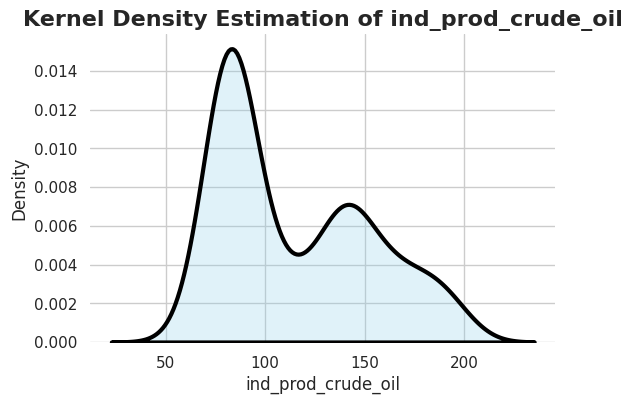

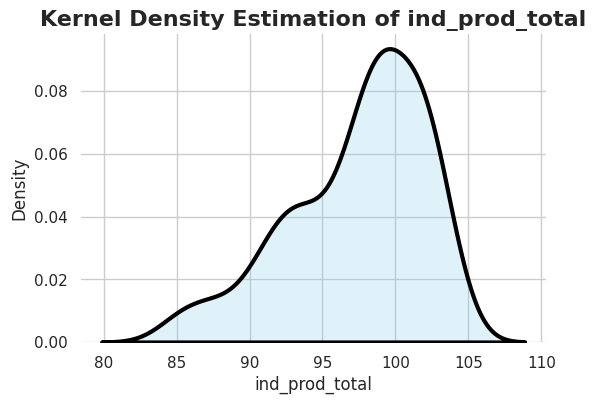

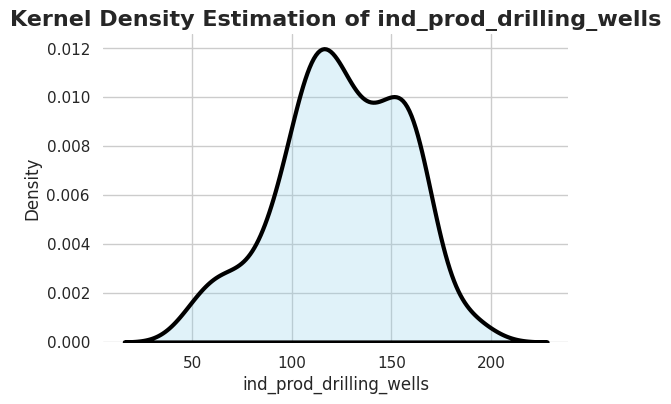

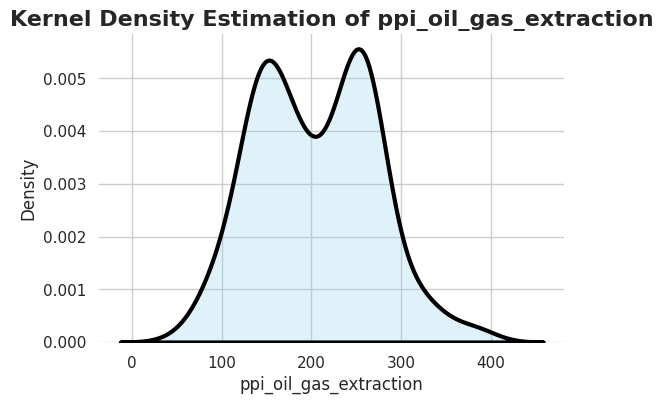

In [143]:
import seaborn as sns
import matplotlib.pyplot as plt

# Set the aesthetic style of the plots
sns.set(style="whitegrid")

# KDE plot
for column in cleaned_data.columns:
    plt.figure(figsize=(6, 4))
    sns.kdeplot(cleaned_data[column], fill=True, color="skyblue", linewidth=3, edgecolor="black")
    plt.title(f'Kernel Density Estimation of {column}', fontsize=16, fontweight='bold')
    plt.xlabel(column, fontsize=12)
    plt.ylabel('Density', fontsize=12)
    sns.despine(left=True, bottom=True)
    plt.show()

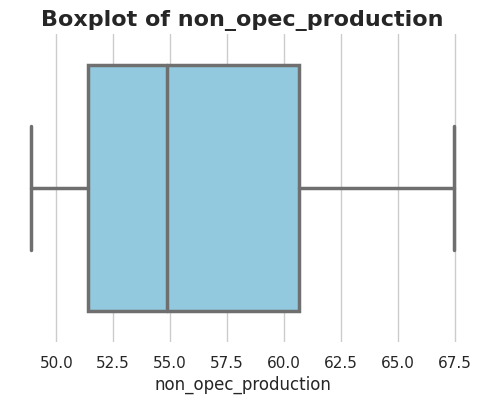

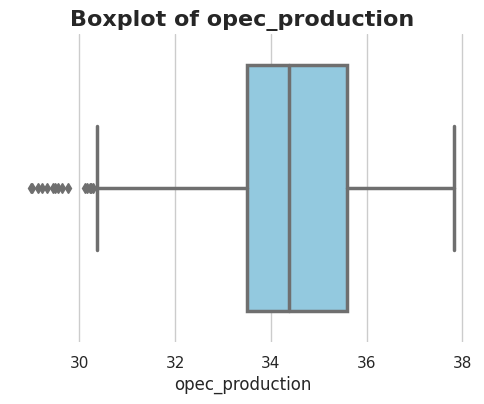

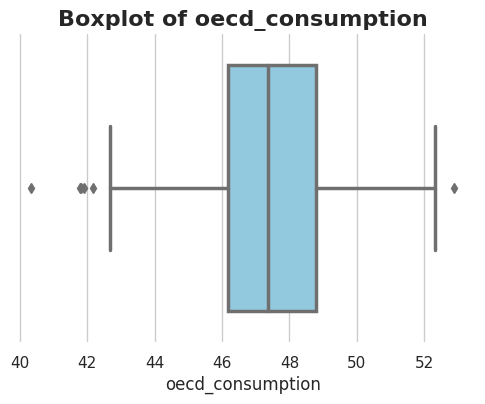

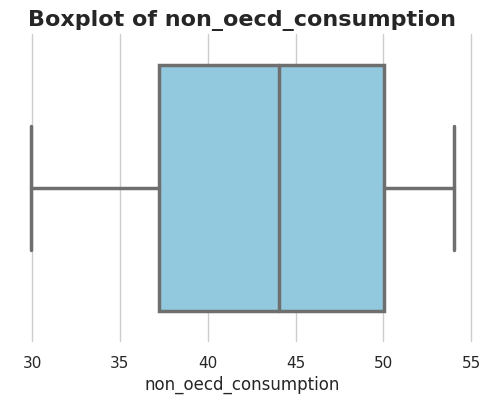

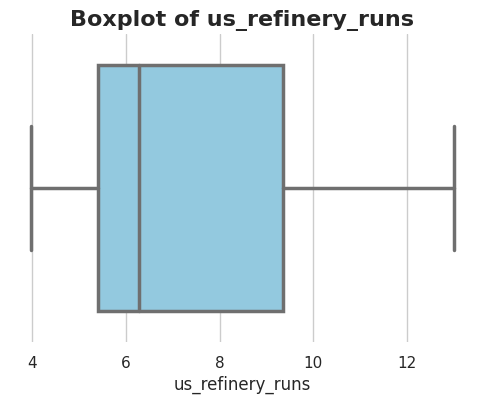

...

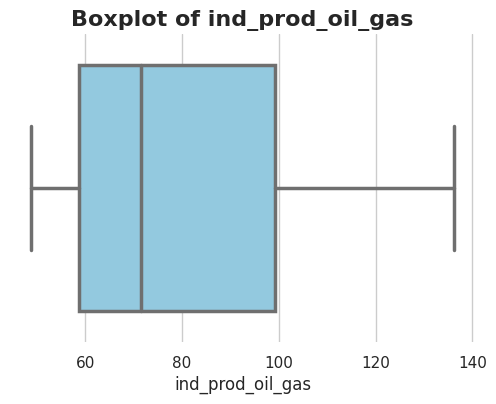

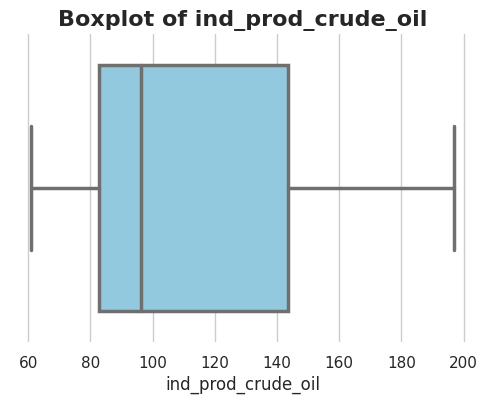

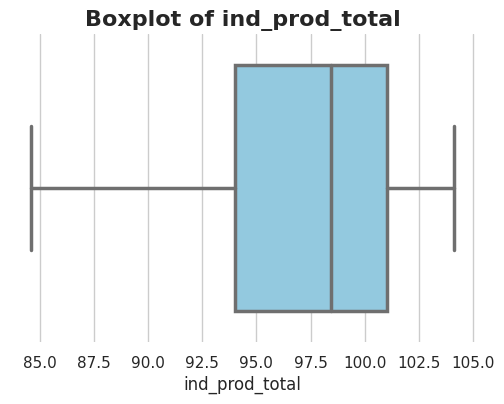

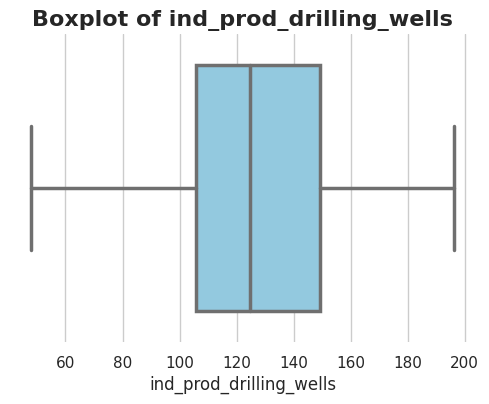

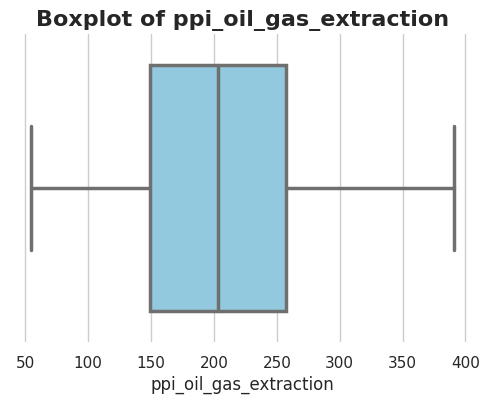

In [144]:
# Box plot
for column in cleaned_data.columns:
    plt.figure(figsize=(6, 4))
    sns.boxplot(x=cleaned_data[column], color="skyblue", linewidth=2.5)
    plt.title(f'Boxplot of {column}', fontsize=16, fontweight='bold')
    plt.xlabel(column, fontsize=12)
    sns.despine(left=True, bottom=True)
    plt.show()


## Step 7b)
Student B - “Time series” plots.


macroeconomic data

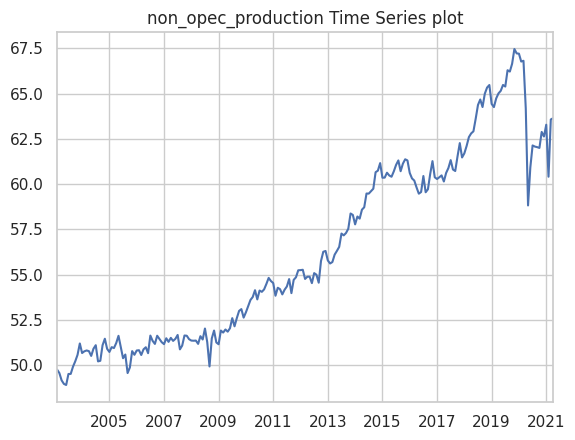

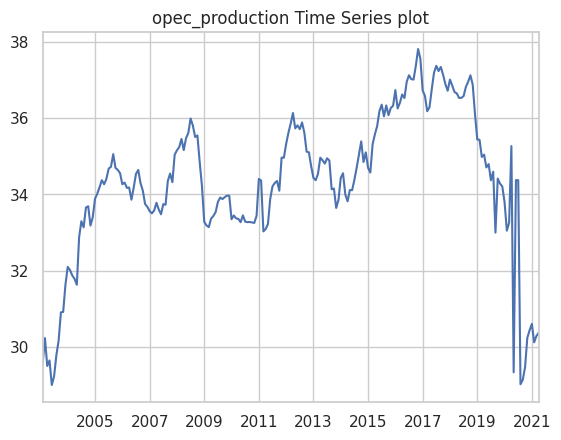

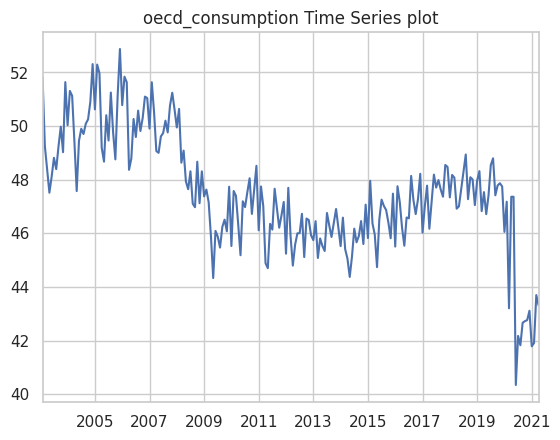

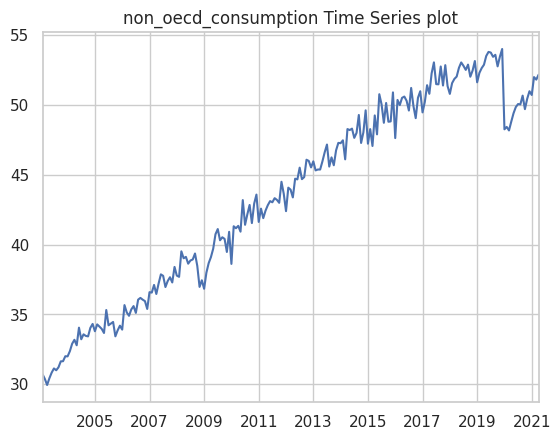

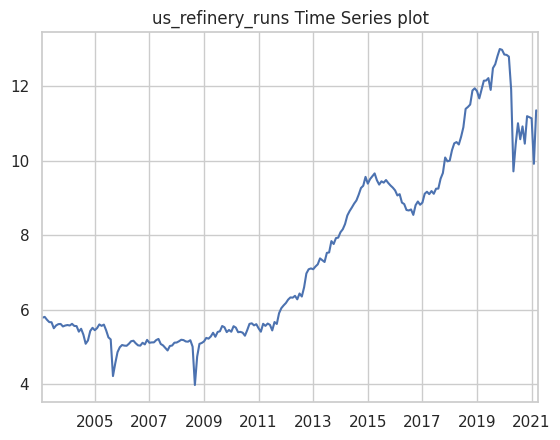

...

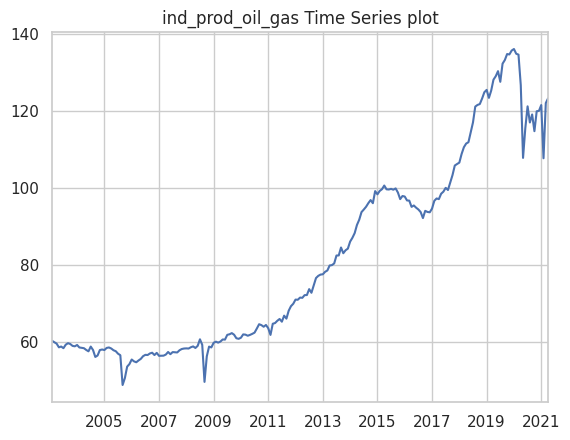

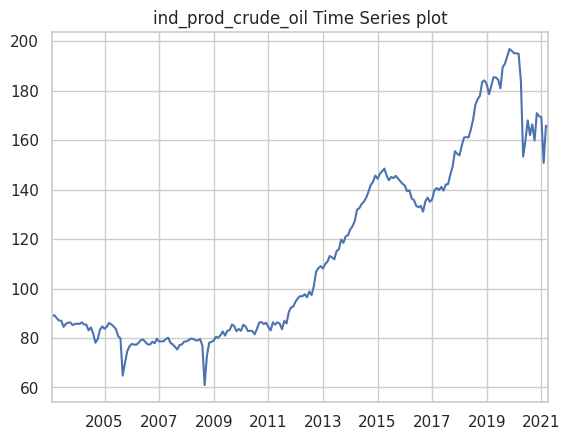

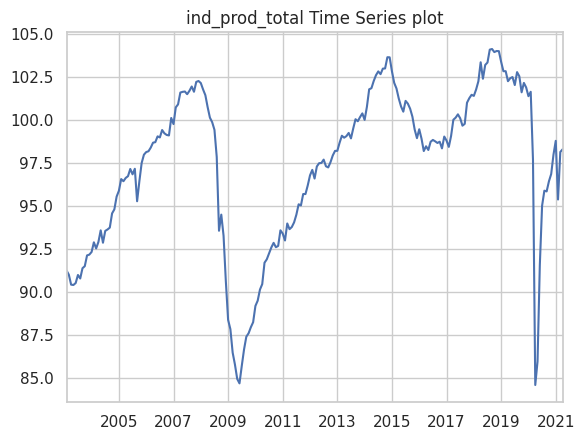

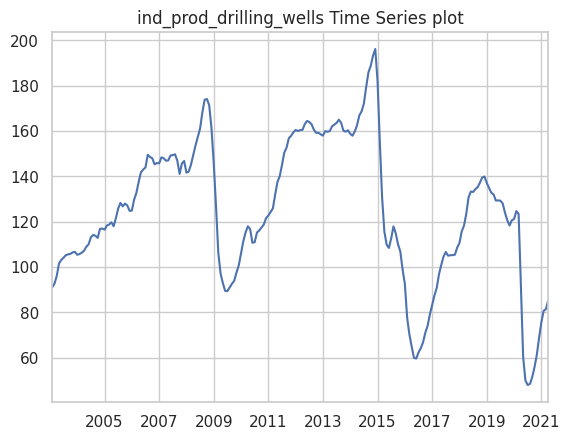

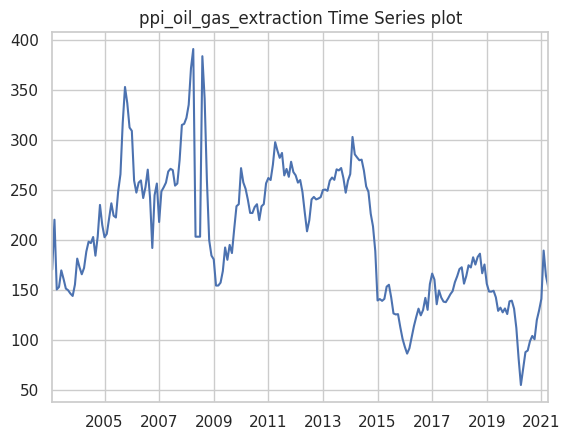

In [147]:
for i in cleaned_data.columns:
  cleaned_data[i].plot()
  plt.title(f"{i} Time Series plot")
  plt.show()

Microeconomic data

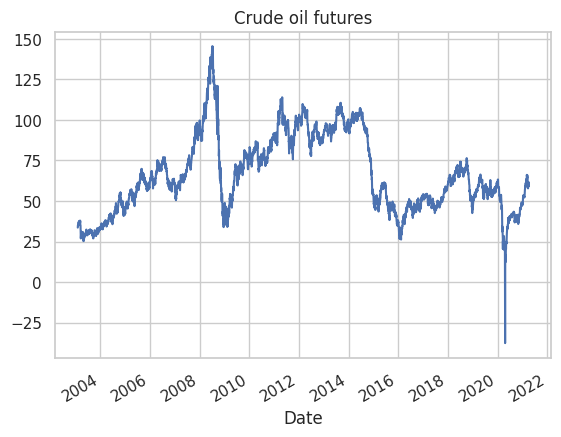

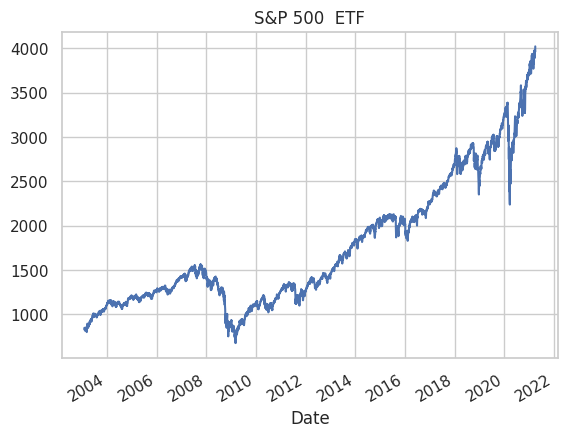

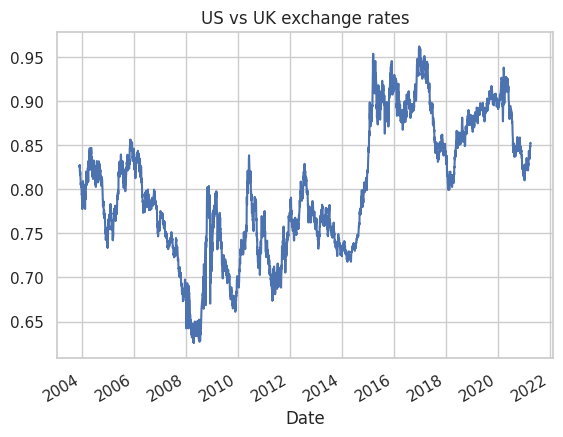

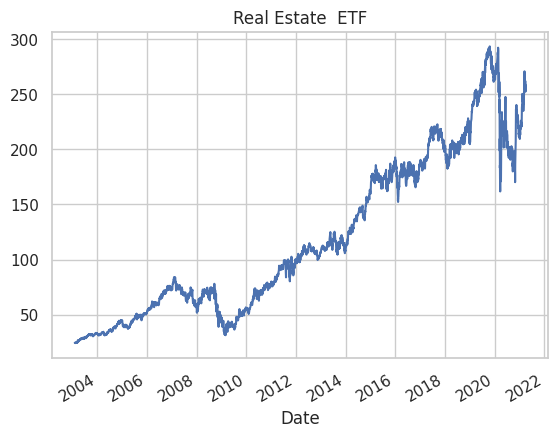

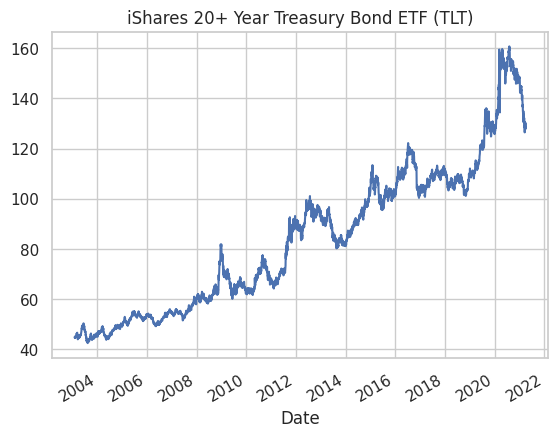

In [149]:
crude_oil_data['Adj Close'].plot()
plt.title("Crude oil futures")
plt.show()
stock_index_data['Adj Close'].plot()
plt.title("S&P 500  ETF")
plt.show()
currency_data['Adj Close'].plot()
plt.title("US vs UK exchange rates")
plt.show()
re_data['Adj Close'].plot()
plt.title("Real Estate  ETF")
plt.show()
bond_data['Adj Close'].plot()
plt.title("iShares 20+ Year Treasury Bond ETF (TLT)")
plt.show()

Financial data

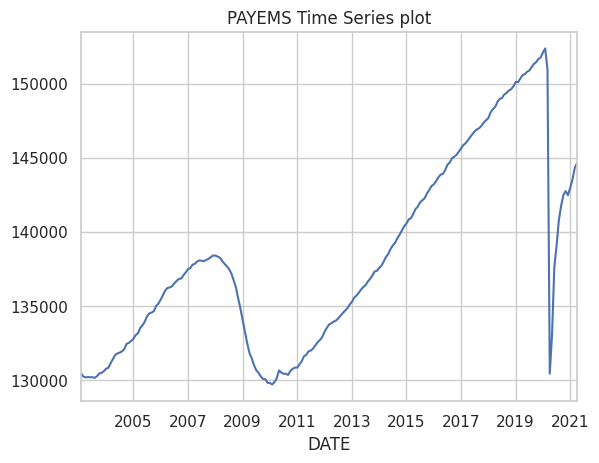

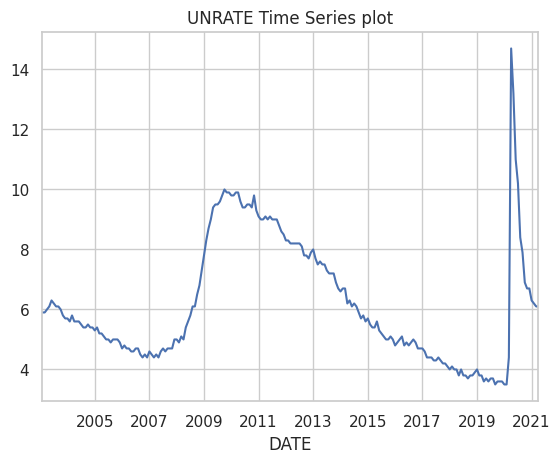

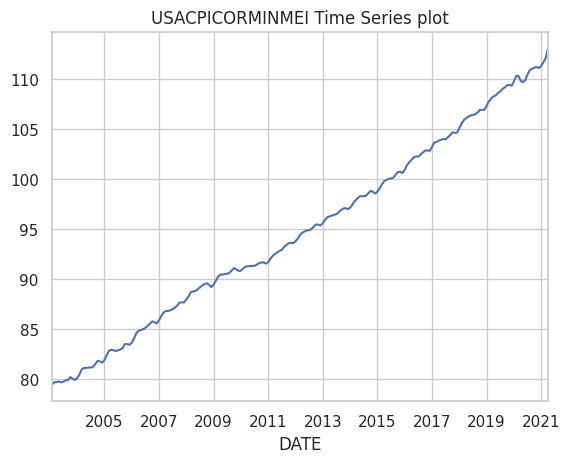

In [150]:
for i in financial_data.columns:
  financial_data[i].plot()
  plt.title(f"{i} Time Series plot")
  plt.show()

## Step 7c)
Student C - “Multivariate” plots


Macroeconomic data

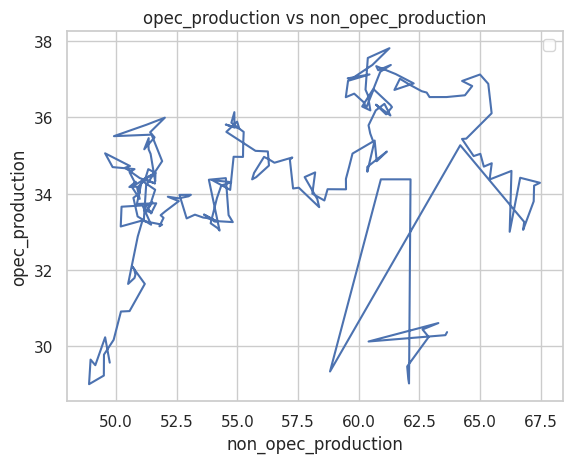

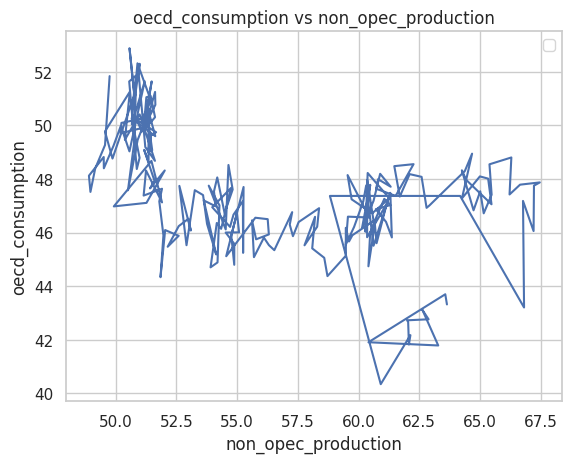

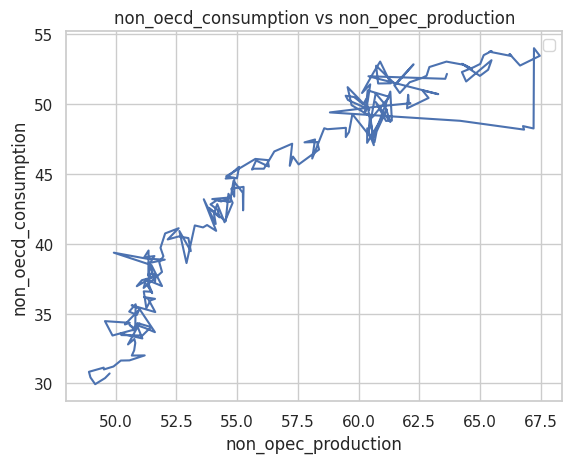

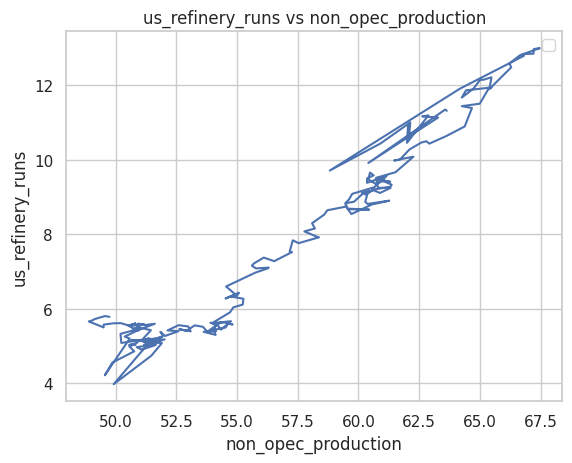

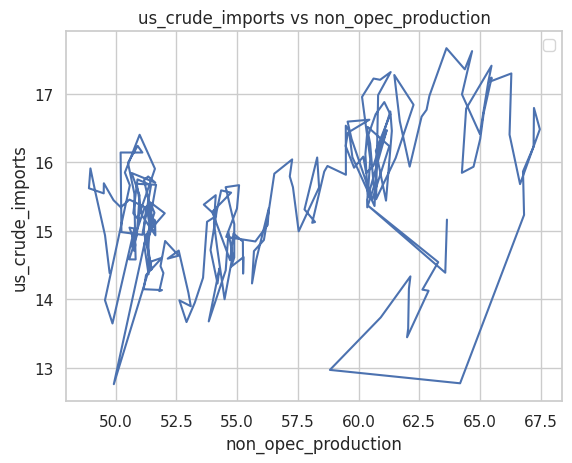

...

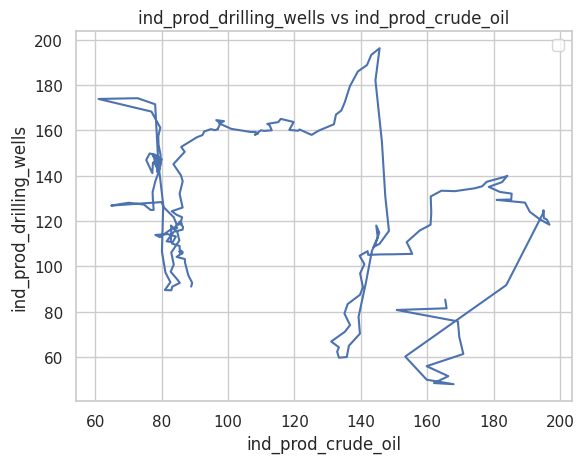

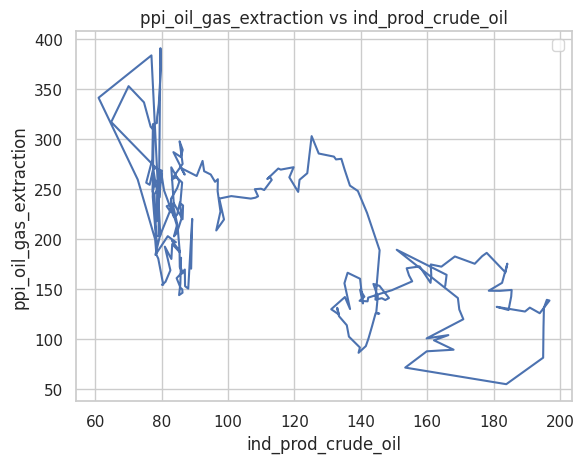

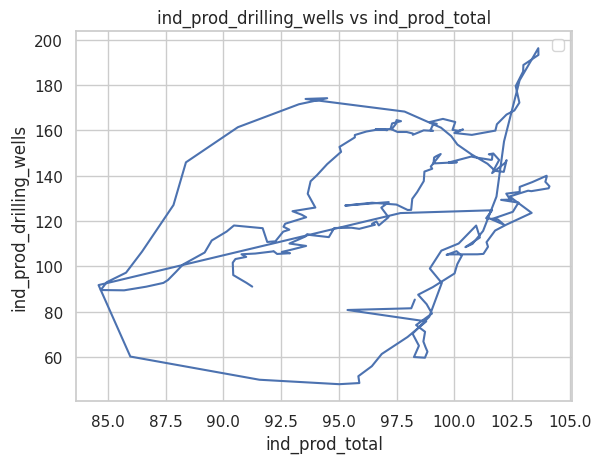

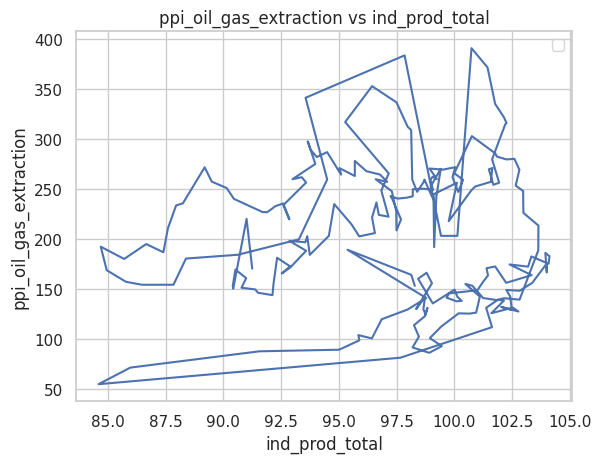

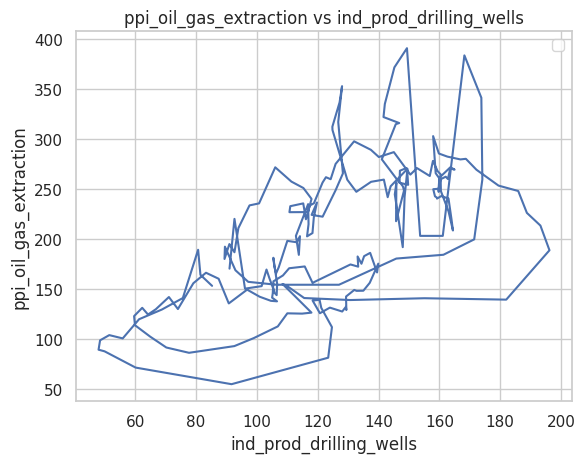

In [153]:
for i in range(len(cleaned_data.columns)):
  for j in range(i+1,len(cleaned_data.columns)):
    plt.plot(cleaned_data.iloc[:,i],cleaned_data.iloc[:,j])
    plt.legend()
    plt.title(f"{cleaned_data.columns[j]} vs {cleaned_data.columns[i]}")
    plt.xlabel(f"{cleaned_data.columns[i]}")
    plt.ylabel(f"{cleaned_data.columns[j]}")
    plt.show()


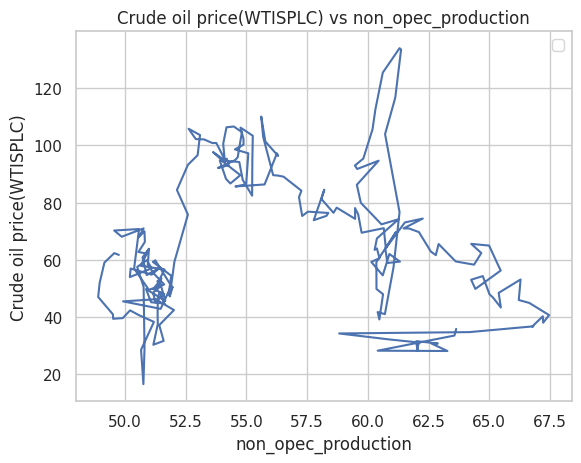

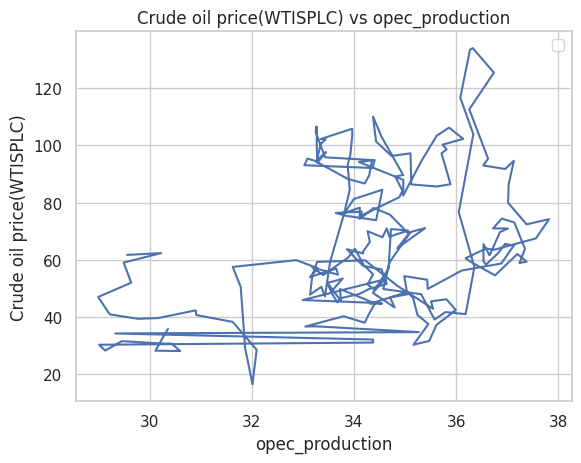

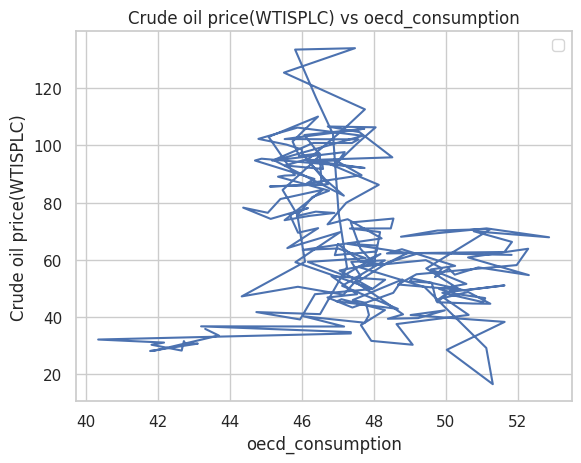

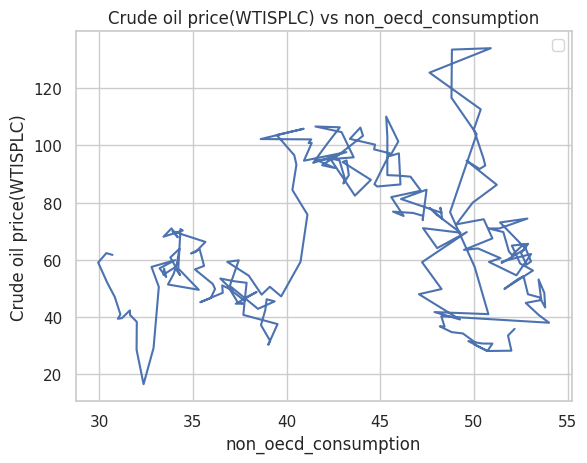

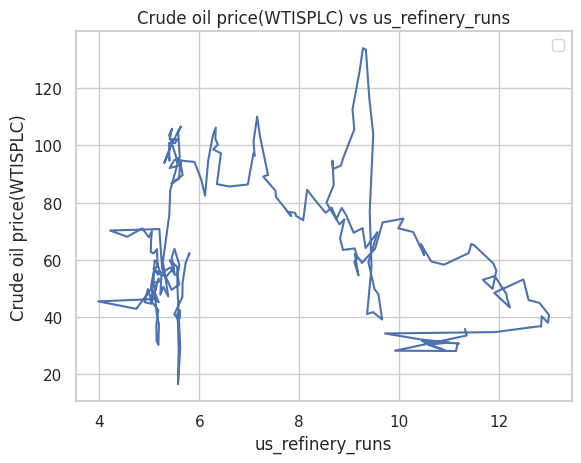

...

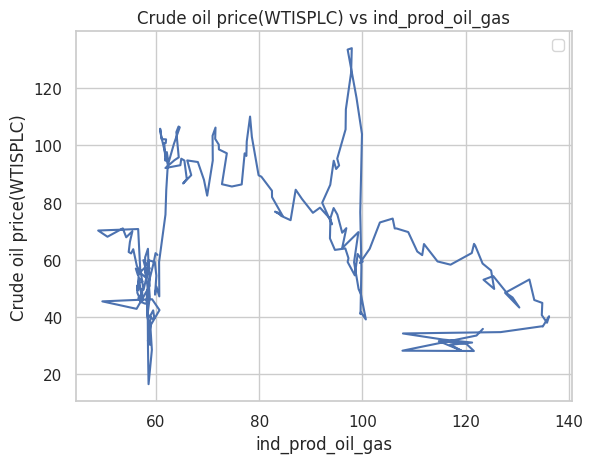

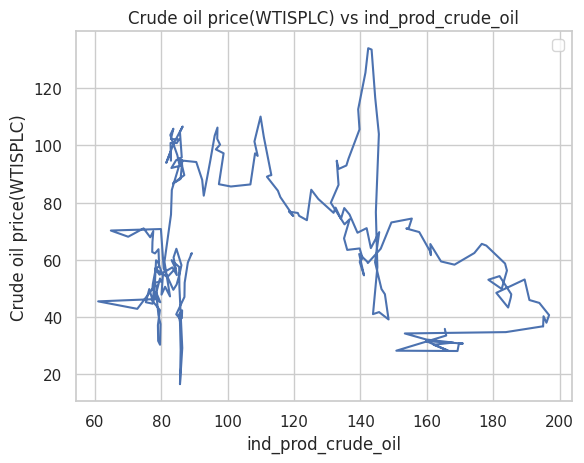

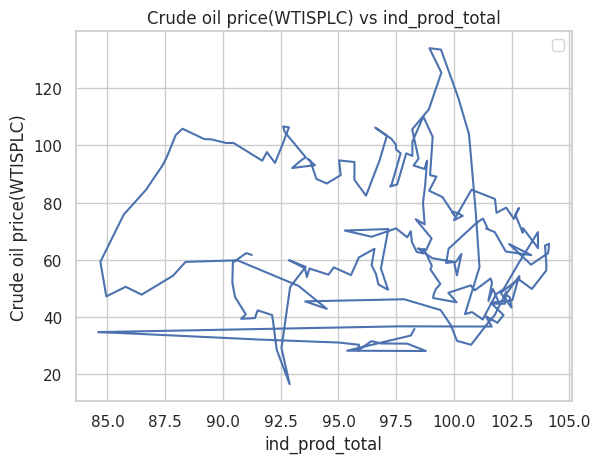

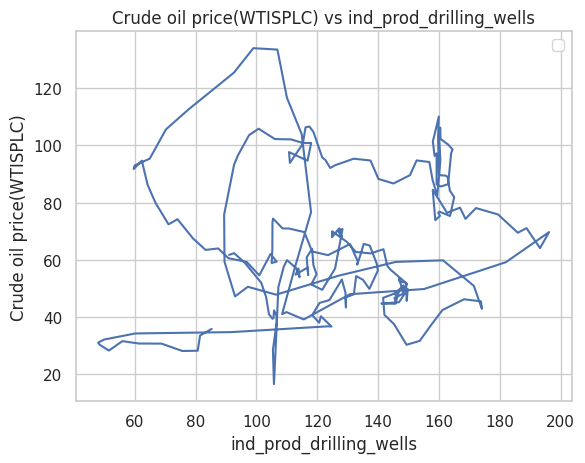

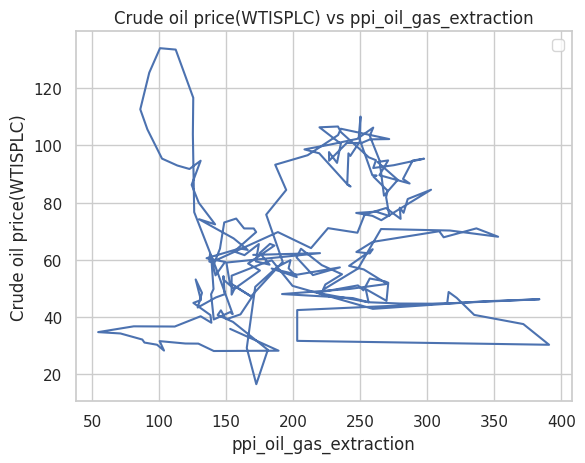

In [157]:
for i in range(len(cleaned_data.columns)):
  plt.plot(cleaned_data.iloc[:,i],fred_crudeoilprice_data.loc[pd.to_datetime(Start_Date):pd.to_datetime(End_Date),'WTISPLC'])
  plt.legend()
  plt.title(f"Crude oil price(WTISPLC) vs {cleaned_data.columns[i]}")
  plt.xlabel(f"{cleaned_data.columns[i]}")
  plt.ylabel(f"Crude oil price(WTISPLC)")
  plt.show()

In [181]:
for i in range(len(cleaned_data.columns)):
  print(f"Correlation of {cleaned_data.columns[i]} with Crude oil prices: {cleaned_data.iloc[:,i].corr(fred_crudeoilprice_data.loc[pd.to_datetime(Start_Date):pd.to_datetime(End_Date),'WTISPLC'])}")


Correlation of non_opec_production with Crude oil prices: -0.14588310666489002
Correlation of opec_production with Crude oil prices: 0.2436724079837997
Correlation of oecd_consumption with Crude oil prices: -0.16251881135292726
Correlation of non_oecd_consumption with Crude oil prices: 0.043919119512430244
Correlation of us_refinery_runs with Crude oil prices: -0.2675975032893832
Correlation of us_crude_imports with Crude oil prices: -0.16352845356352239
Correlation of us_opec_imports with Crude oil prices: 0.25455338328098115
Correlation of oecd_comm_inventory with Crude oil prices: -0.4255311651380958
Correlation of opec_spare_capacity with Crude oil prices: 0.13828625164540403
Correlation of opec_capacity with Crude oil prices: 0.3610182797248918
Correlation of oecd_inventory_change with Crude oil prices: 0.02685425945331788
Correlation of non_oecd_inventory_change with Crude oil prices: 0.0774553281228654
Correlation of cpi_energy with Crude oil prices: 0.8489879405431326
Correlati

Financial data

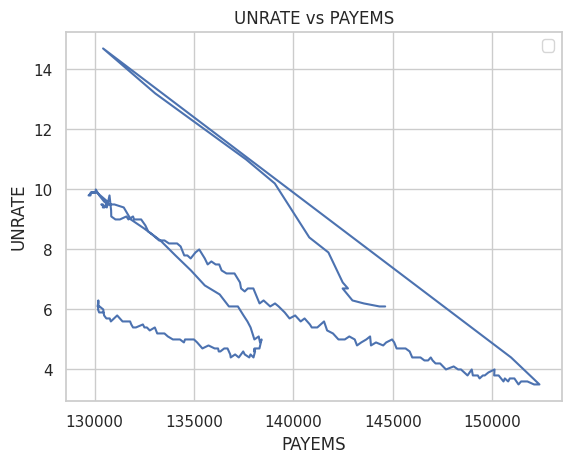

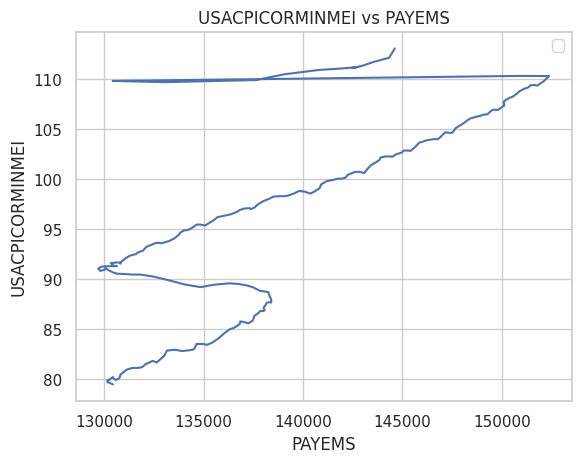

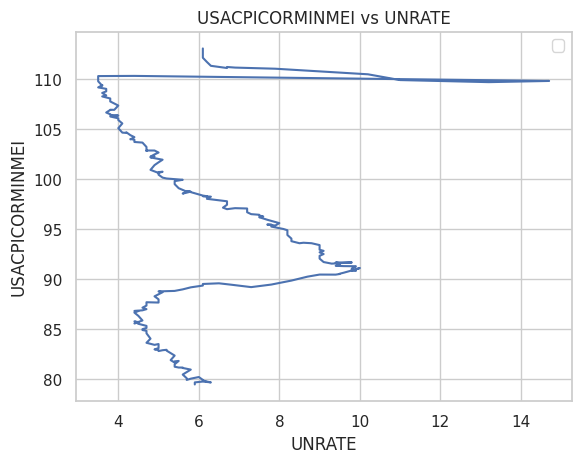

In [154]:
for i in range(len(financial_data.columns)):
  for j in range(i+1,len(financial_data.columns)):
    plt.plot(financial_data.iloc[:,i],financial_data.iloc[:,j])
    plt.legend()
    plt.title(f"{financial_data.columns[j]} vs {financial_data.columns[i]}")
    plt.xlabel(f"{financial_data.columns[i]}")
    plt.ylabel(f"{financial_data.columns[j]}")
    plt.show()

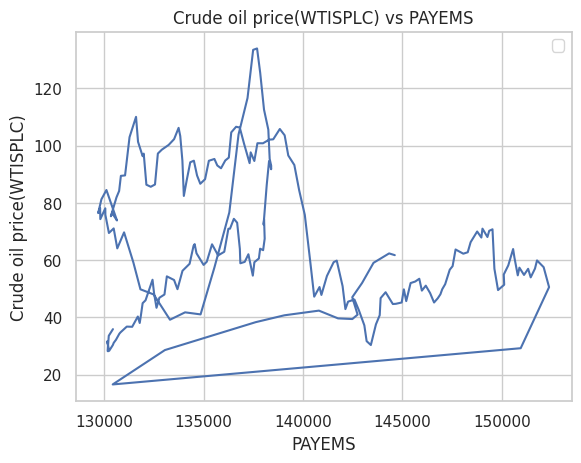

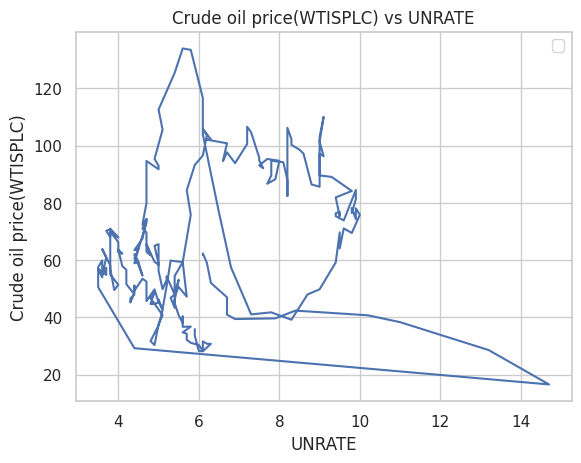

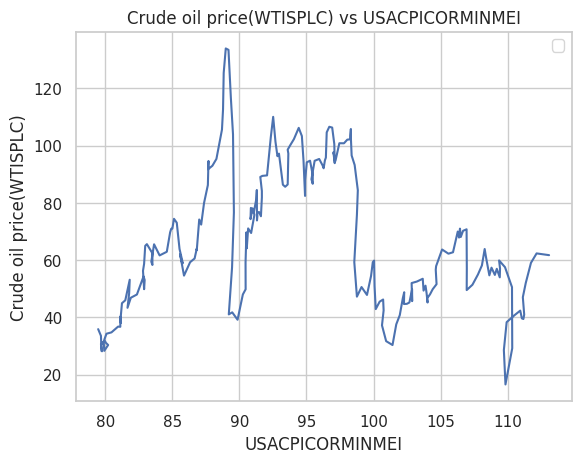

In [158]:
for i in range(len(financial_data.columns)):
  plt.plot(financial_data.iloc[:,i],fred_crudeoilprice_data.loc[pd.to_datetime(Start_Date):pd.to_datetime(End_Date),'WTISPLC'])
  plt.legend()
  plt.title(f"Crude oil price(WTISPLC) vs {financial_data.columns[i]}")
  plt.xlabel(f"{financial_data.columns[i]}")
  plt.ylabel(f"Crude oil price(WTISPLC)")
  plt.show()

# Step 8
a. What makes oil prices look different from other asset prices? E.g., spikes,
clustered volatility, seasonality, etc.

b. What types of distributions do oil returns have?

c. What type of autocorrelation do the oil returns have?

d. What other stylized facts can you say about oil prices?


a)

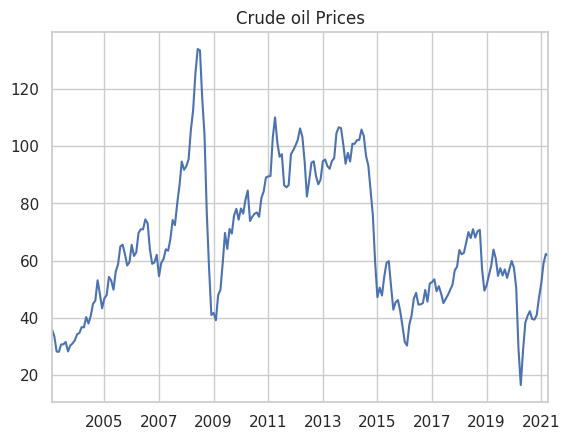

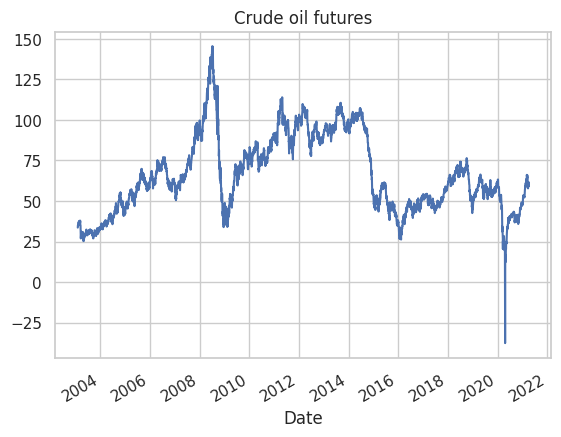

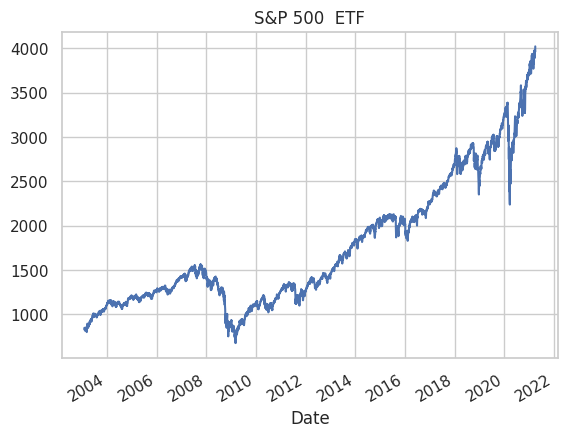

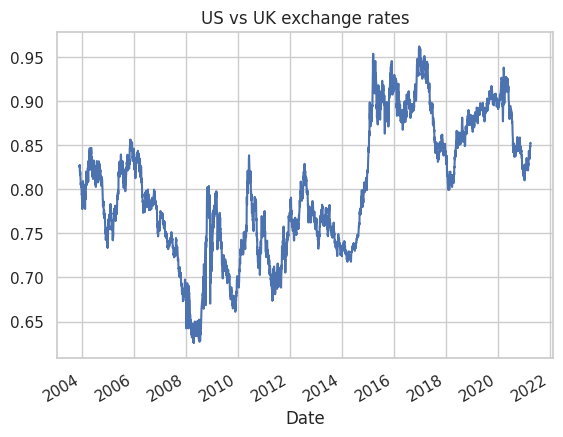

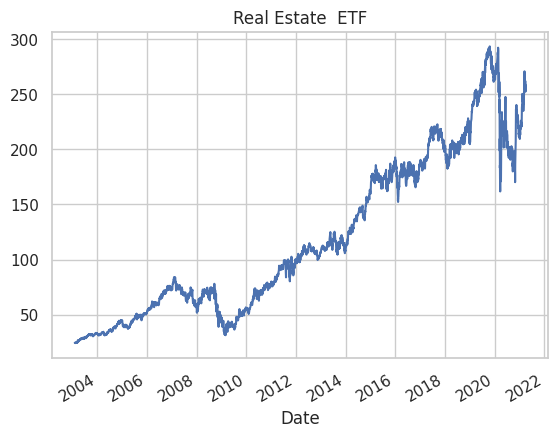

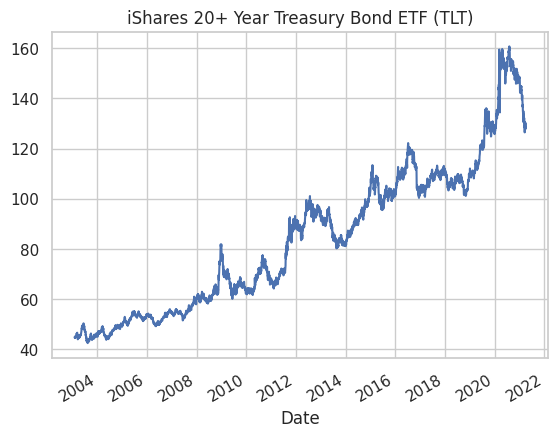

In [160]:
fred_crudeoilprice_data.loc[pd.to_datetime(Start_Date):pd.to_datetime(End_Date),'WTISPLC'].plot()
plt.title("Crude oil Prices")
plt.show()
crude_oil_data['Adj Close'].plot()
plt.title("Crude oil futures")
plt.show()
stock_index_data['Adj Close'].plot()
plt.title("S&P 500  ETF")
plt.show()
currency_data['Adj Close'].plot()
plt.title("US vs UK exchange rates")
plt.show()
re_data['Adj Close'].plot()
plt.title("Real Estate  ETF")
plt.show()
bond_data['Adj Close'].plot()
plt.title("iShares 20+ Year Treasury Bond ETF (TLT)")
plt.show()

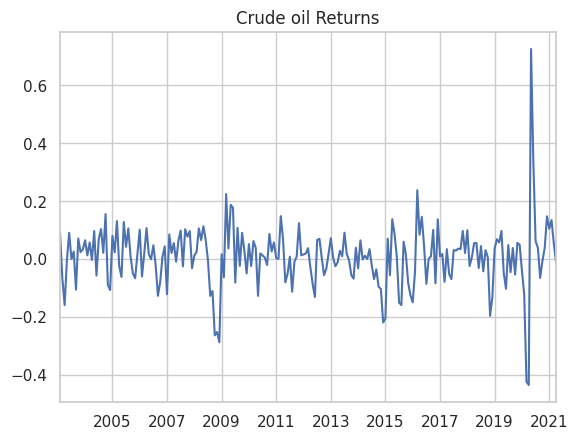

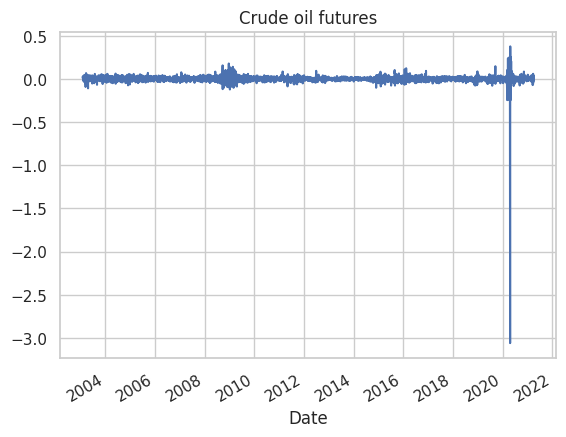

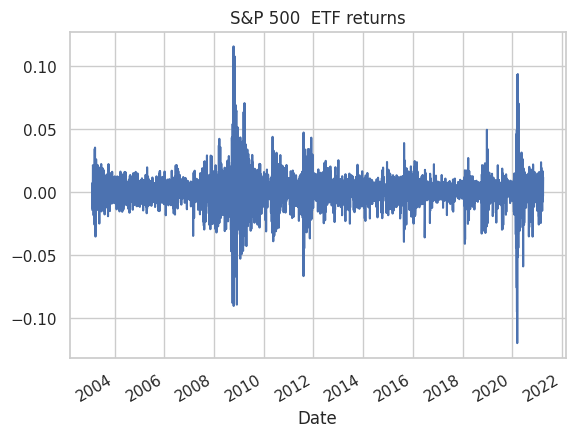

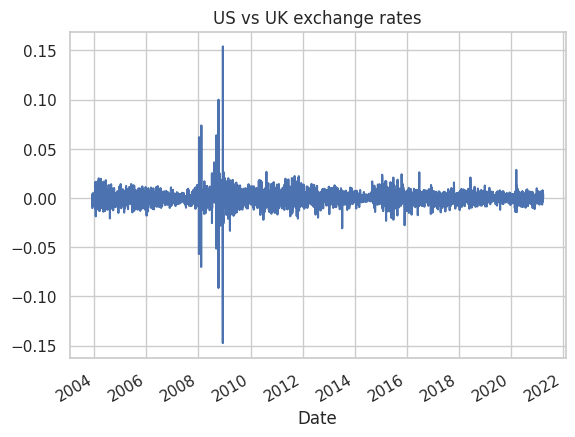

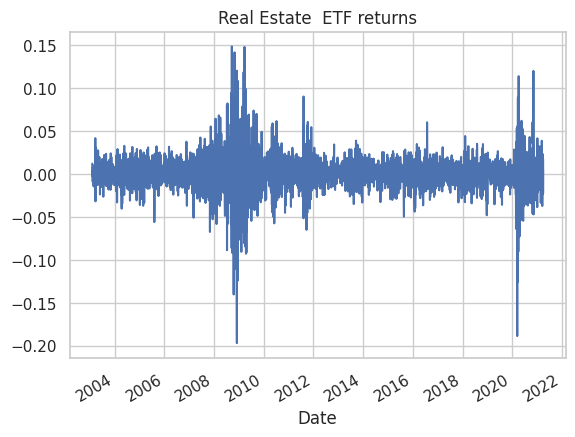

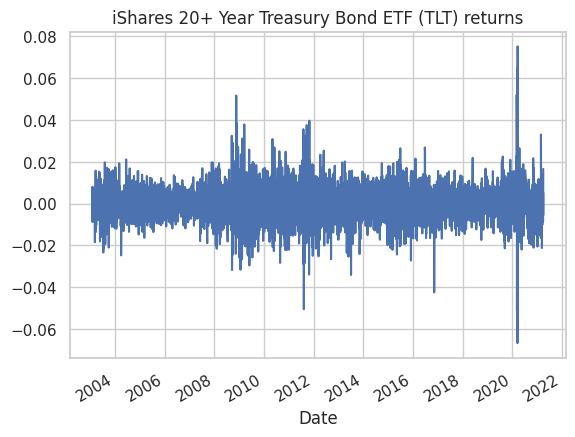

In [163]:
fred_crudeoilprice_data.loc[pd.to_datetime(Start_Date):pd.to_datetime(End_Date),'returns'].plot()
plt.title("Crude oil Returns")
plt.show()
crude_oil_data['returns'].plot()
plt.title("Crude oil futures")
plt.show()
stock_index_data['returns'].plot()
plt.title("S&P 500  ETF returns")
plt.show()
currency_data['returns'].plot()
plt.title("US vs UK exchange rates")
plt.show()
re_data['returns'].plot()
plt.title("Real Estate  ETF returns")
plt.show()
bond_data['returns'].plot()
plt.title("iShares 20+ Year Treasury Bond ETF (TLT) returns")
plt.show()

b)

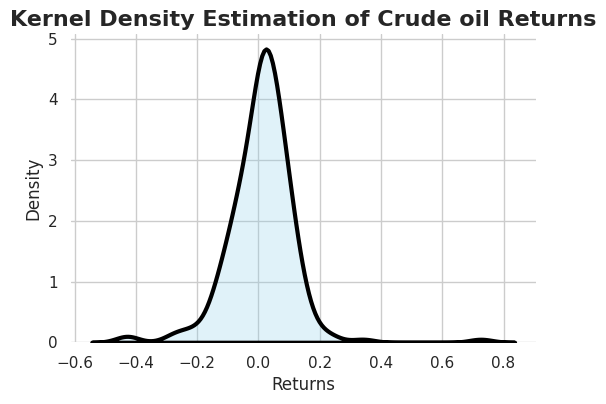

In [164]:
plt.figure(figsize=(6, 4))
sns.kdeplot(fred_crudeoilprice_data.loc[pd.to_datetime(Start_Date):pd.to_datetime(End_Date),"returns"], fill=True, color="skyblue", linewidth=3, edgecolor="black")
plt.title(f'Kernel Density Estimation of Crude oil Returns', fontsize=16, fontweight='bold')
plt.xlabel("Returns", fontsize=12)
plt.ylabel('Density', fontsize=12)
sns.despine(left=True, bottom=True)
plt.show()

In [165]:
fred_crudeoilprice_data.loc[pd.to_datetime(Start_Date):pd.to_datetime(End_Date),"returns"].describe()

count    219.000000
mean       0.008733
std        0.107935
min       -0.433413
25%       -0.045868
50%        0.016942
75%        0.063210
max        0.725680
Name: returns, dtype: float64

In [168]:
from scipy import stats

stat, p = stats.shapiro(fred_crudeoilprice_data.loc[pd.to_datetime(Start_Date):pd.to_datetime(End_Date),"returns"])

print(f"Shapiro-Wilk Test Statistic: {stat}")
print(f"P-value: {p}")

# Check the p-value against your chosen significance level
significance_level = 0.05
if p > significance_level:
    print("Data appears to be normally distributed (fail to reject H0)")
else:
    print("Data does not appear to be normally distributed (reject H0)")

Shapiro-Wilk Test Statistic: 0.877755343914032
P-value: 2.711822736853331e-12
Data does not appear to be normally distributed (reject H0)


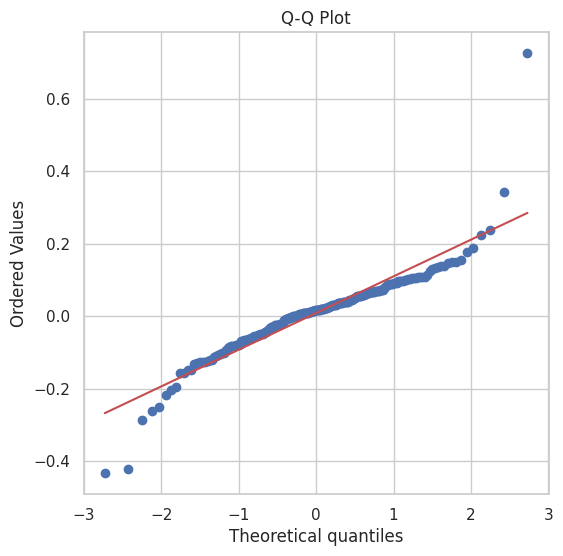

In [169]:
mean = np.mean(fred_crudeoilprice_data.loc[pd.to_datetime(Start_Date):pd.to_datetime(End_Date),"returns"])
std = np.std(fred_crudeoilprice_data.loc[pd.to_datetime(Start_Date):pd.to_datetime(End_Date),"returns"])
normal_data = np.random.normal(mean, std, len(data))

# Create a Q-Q plot
plt.figure(figsize=(6, 6))
stats.probplot(fred_crudeoilprice_data.loc[pd.to_datetime(Start_Date):pd.to_datetime(End_Date),"returns"], dist="norm", plot=plt)
plt.title("Q-Q Plot")
plt.show()

c)

In [178]:
import statsmodels.api as sm
autocorr=[]
for lag in range(1,21,1):
  ts=fred_crudeoilprice_data.loc[pd.to_datetime(Start_Date):pd.to_datetime(End_Date),"returns"]
  autocorr.append((lag,ts.autocorr(lag=lag)))

autocorr



[(1, 0.23670318698216952),
 (2, -0.045783438832546194),
 (3, -0.13434269207557736),
 (4, -0.1377336122091611),
 (5, -0.010316305686306175),
 (6, -0.01633037264515368),
 (7, 0.009220789150786172),
 (8, -0.0454657429651939),
 (9, -0.04070632559894875),
 (10, 0.0007959806427623273),
 (11, -0.04045062167639942),
 (12, -0.04741942564598494),
 (13, -0.01550850095256125),
 (14, -0.02486944999196639),
 (15, 0.060272905197739896),
 (16, 0.05181501524443728),
 (17, -0.02270211417950196),
 (18, -0.12893932057601873),
 (19, -0.025740576114166934),
 (20, 0.05989344909257324)]

Therefore, highest autocorrelation is at lag 1.

In [159]:
# Function to classify the distribution for Macroeconomic
from scipy.stats import kurtosis
def classify_distribution(data_column):
    kurt = kurtosis(data_column)
    if kurt > 3:
        return "Leptokurtic"
    elif kurt < 3:
        return "Platykurtic"
    else:
        return "Mesokurtic (normal-like)"

table = []
for column in cleaned_data.columns:
    distribution_type = classify_distribution(cleaned_data[column])
    table.append([column, distribution_type])

headers = ["Data", "Distribution Type"]
print(tabulate(table, headers=headers, tablefmt="fancy_grid"))

╒═══════════════════════════╤═════════════════════╕
│ Data                      │ Distribution Type   │
╞═══════════════════════════╪═════════════════════╡
│ non_opec_production       │ Platykurtic         │
├───────────────────────────┼─────────────────────┤
│ opec_production           │ Platykurtic         │
├───────────────────────────┼─────────────────────┤
│ oecd_consumption          │ Platykurtic         │
├───────────────────────────┼─────────────────────┤
│ non_oecd_consumption      │ Platykurtic         │
├───────────────────────────┼─────────────────────┤
│ us_refinery_runs          │ Platykurtic         │
├───────────────────────────┼─────────────────────┤
│ us_crude_imports          │ Platykurtic         │
├───────────────────────────┼─────────────────────┤
│ us_opec_imports           │ Platykurtic         │
├───────────────────────────┼─────────────────────┤
│ oecd_comm_inventory       │ Platykurtic         │
├───────────────────────────┼─────────────────────┤
│ opec_spare

## Step 9a)
Student A - Define probabilistic graphic models and distinguish belief
networks and Markov networks.


Probabilistic graphical models(PGM), are frameworks for representing and reasoning about uncertainty in complex systems. They combine principles from probability theory and graph theory to model the relationships/dependencies among a set of random variables.

In a probabilistic graphical model:

**Nodes** represent random variables, which can take on various values with associated probabilities.

**Edges** between nodes indicate probabilistic dependencies or relationships. These edges express how the variables influence each other.

The graph structure defines the joint probability distribution over all variables and thus enables efficient inference and reasoning.

PGMs can be classified into two main types:
**Bayesian Networks** (Belief Networks) use directed acyclic graphs to represent causal relationships, while **Markov Networks** use undirected graphs to represent pairwise dependencies.

| Criteria                        | Belief Networks (Bayesian Networks) | Markov Networks (Markov Random Fields) |
|---------------------------------|------------------------------------|---------------------------------------|
| **Graph Structure**             | Directed Acyclic Graph (DAG)       | Undirected Graph (No specific order)  |
| **Node Interpretation**| Nodes represent random variables | Nodes represent factors or cliques |
| **Graph Structure**    | Contains directed edges         | Contains undirected edges       |
| **Edge Semantics**     | Uses conditional probabilities  | Uses potential functions        |
| **Propagation**        | Often used for inference        | Often used for modeling         |
| **Cycle**              | Must be acyclic                | Cycles are allowed              |
| **Dependency Type**    | Represent conditional dependencies | Represent pairwise dependencies |
| **Edge Interpretation**| Represents direct causality     | Represents statistical dependence |              |
| **Causality Representation**    | Good for modeling causality         | Focuses more on pairwise dependencies |
| **Global vs. Local**            | Captures both global and local dependencies | Primarily captures local dependencies |
| **Inference**                   | Efficient for exact inference (e.g., Variable Elimination) | Generally requires approximate methods (e.g., Markov Chain Monte Carlo) |
| **Parameterization**            | Requires specifying conditional probabilities | Requires specifying factors and potentials |


# Step 10
pseudocode version of Algorithm1: Inferred Causality.

**Algorithm: Inferred Causality**

**Inputs:**
1. `data_set`: A dataset containing variables `Xi`, where `i` ranges from 1 to `m`.

**Outputs:**
1. `G`: A partially directed graphical model.

**Phase 1: Learning Markov Blankets**

1. Initialize an empty dictionary `markov_blankets` to store the Markov blankets of each variable.
2. For each variable `Xi` in the dataset, do the following:
   -  Learn its Markov blanket `B(Xi)` (a set of variables that are probabilistically dependent on `Xi`).
   -  Store `B(Xi)` in the `markov_blankets` dictionary with `Xi` as the key.
3. Check if the Markov blankets are symmetric, meaning if `Xi` is in the Markov blanket of `Xj`, then `Xj` should also be in the Markov blanket of `Xi`. Remove any asymmetric relationships as false positives.
4. Return the symmetric Markov blankets.

**Phase 2: Learning Neighbors**

1. Initialize an empty dictionary `partial_dag` to represent the partially directed acyclic graph (DAG).
2. For each pair of variables `Xi` and `Xj` in the symmetric Markov blankets:
   -  Attempt to find a set `SXiXj` such that `Xi` is conditionally independent of `Xj` given `SXiXj`, and neither `Xi` nor `Xj` are in `SXiXj`.
   -  If `SXiXj` is not found, place an undirected arc between `Xi` and `Xj` in `partial_dag`.
3. Check if the neighbors in `partial_dag` are symmetric and correct any asymmetries.

**Phase 3: Learning Arc Directions**

1. Create a copy of the symmetric DAG as `completed_dag`.
2. For each pair of non-adjacent variables `Xi` and `Xj` with a common neighbor `Xk` that is not in `SXiXj`:
   a. Set the directions of the arcs `Xi → Xk` and `Xk → Xj` to obtain a V-structure (`Xi → Xk ← Xj`).
3. Set the direction of the remaining undirected arcs using the following rules recursively:
    -  If there exists a strictly directed path from `Xi` to `Xj`, set the direction as `Xi → Xj`.
    -  If `Xi` and `Xj` are not adjacent and `Xi → Xk` and `Xk → Xj`, then set `Xk → Xj`.

**Main Algorithm**

1. Execute the following steps in sequence:
    -  Learn the symmetric Markov blankets for each variable.
    -  Learn the neighbors based on the Markov blankets.
    -  Learn the arc directions within the graph.
2. Return the completed partially directed graphical model `G`.

In [ ]:
# Inputs
data_set

# Outputs
G = partially directed graphical model

# Phase 1: learning Markov blankets
def learn_markov_blankets(data_set):
    markov_blankets = {}
    for variable in data_set:
        markov_blanket = find_markov_blanket(variable, data_set)
        markov_blankets[variable] = markov_blanket
    symmetric_blankets = check_symmetry(markov_blankets)
    return symmetric_blankets

def check_symmetry(markov_blankets):
    symmetric_blankets = {}
    for var1, blanket1 in markov_blankets.items():
        for var2, blanket2 in markov_blankets.items():
            if var1 != var2 and set(blanket1) == set(blanket2):
                symmetric_blankets[var1] = blanket1
                symmetric_blankets[var2] = blanket2
    return symmetric_blankets


# Phase 2: Learning Neighbours
def learn_neighbours(symmetric_blankets, data_set):
    partial_dag = {}
    for var1 in symmetric_blankets:
        for var2 in symmetric_blankets:
            if var1 != var2:
                s_xi_xj = find_sxi_xj(var1, var2, symmetric_blankets, data_set)
                if not s_xi_xj:
                    partial_dag[var1][var2] = None
    symmetric_dag = check_symmetry(partial_dag)
    return symmetric_dag

# Phase 3: Learning Arc Directions
def learn_arc_directions(symmetric_dag):
    completed_dag = symmetric_dag.copy()
    for var1 in symmetric_dag:
        for var2 in symmetric_dag:
            if var1 != var2 and not symmetric_dag[var1][var2]:
                common_neighbors = find_common_neighbors(var1, var2, completed_dag)
                for neighbor in common_neighbors:
                    if neighbor not in completed_dag[var1] or completed_dag[var1][neighbor]:
                        continue
                    if neighbor not in completed_dag[var2] or completed_dag[var2][neighbor]:
                        continue
                    completed_dag[var1][neighbor] = '->'
                    completed_dag[neighbor][var2] = '->'
    completed_dag = apply_direction_rules(completed_dag)
    return completed_dag

# Main Algorithm
def inferred_causality(data_set):
    symmetric_blankets = learn_markov_blankets(data_set)
    symmetric_dag = learn_neighbours(symmetric_blankets, data_set)
    completed_dag = learn_arc_directions(symmetric_dag)
    return completed_dag

data_set = {}
G = inferred_causality(data_set)